In [0]:
import numpy as np
import time
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [0]:
def Laplacian_of_Gaussian(n, sigma):
    laplacian = np.array([range(-n//2+1, n//2+1, 1) for _ in range(n)])
    common_factor = (np.square(laplacian)+np.square(laplacian.T))
    laplacian = (common_factor-2*np.square(sigma))*np.exp(-common_factor/(2*np.square(sigma)))
    return laplacian
def Gaussian_filter(n, sigma):
    gaus_filter = np.array([range(-n//2+1, n//2+1, 1) for _ in range(n)])
    gaus_filter = np.square(gaus_filter) + np.square(gaus_filter.T)
    gaus_filter = (1/(2*np.pi*np.square(sigma)))*np.exp(-gaus_filter/(2*np.square(sigma)))
    #gaus_filter = np.repeat(gaus_filter, 3).reshape(n, n, 3)
    return(gaus_filter) 
def dog(k,n,sigma):
    a=Gaussian_filter(n,sigma)
    b=Gaussian_filter(n,k*sigma)
    return b-a  
def padding(image, n):
    padded_image = np.concatenate((np.array([image[0] for _ in range(n//2)]), image, np.array([image[-1] for _ in range(n//2)])), axis=0)
    padded_image = np.concatenate((np.repeat(padded_image[:, 0:1],n//2, axis=1), padded_image, np.repeat(padded_image[:, -1:],n//2, axis=1)), axis=1)
    return padded_image
def apply_filter(img, lapl):
    M, N = img.shape
    K = lapl.shape[0]
    final_image = np.zeros(img.shape)
    for i in range(M-K):
        for j in range(N-K):
            final_image[i+K//2, j+K//2] = np.multiply(img[i:i+K, j:j+K], lapl).sum()
    return np.square(final_image)
def max_filter(img, K, sigma):
    M, N = img.shape
    final_image = np.zeros(img.shape)
    plt.figure()
    fig, ax = plt.subplots()
    for i in range(M-K):
        for j in range(N-K):
            if(img[i+K//2, j+K//2] == np.max(img[i:i+K, j:j+K])):
                final_image[i+K//2, j+K//2] = np.sqrt(2)*sigma
                ax.add_artist(plt.Circle((j+K//2, i+K//2), np.sqrt(2)*sigma, color='r', fill = False, linewidth=3))
    plt.imshow(final_image, cmap="gray")
    plt.show()
    return final_image

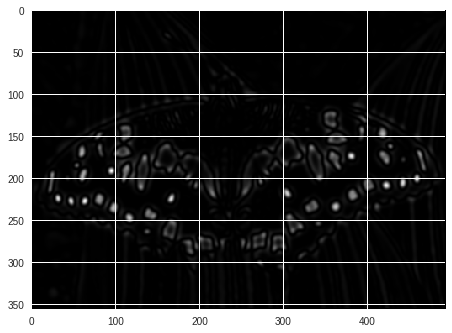

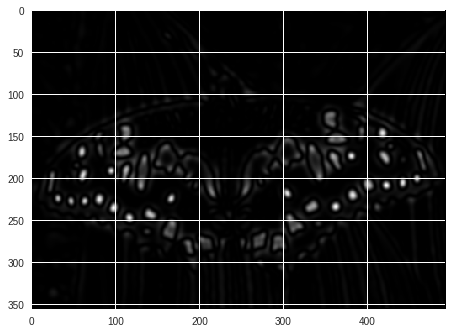

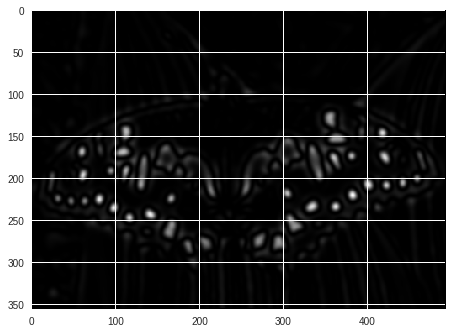

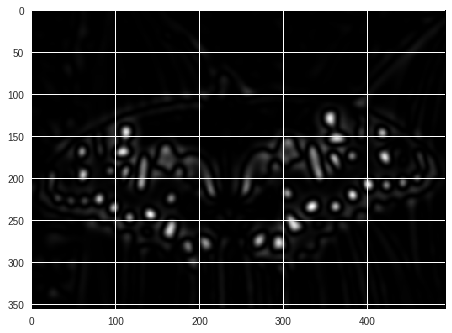

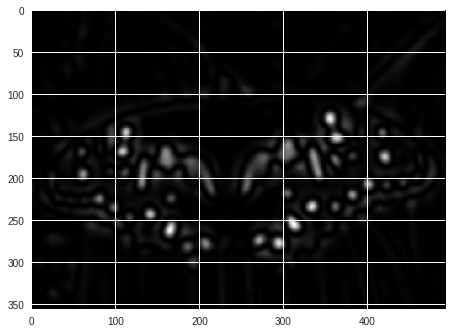

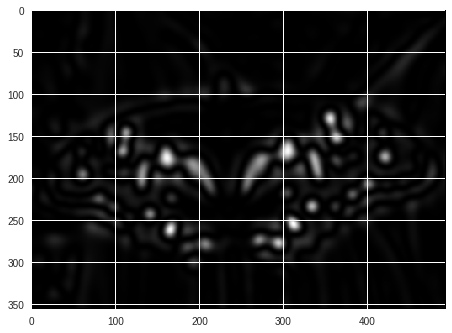

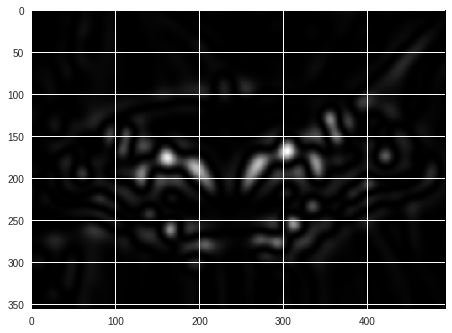

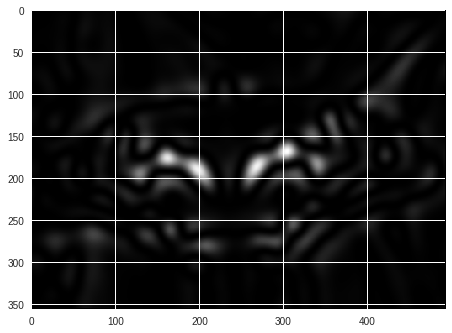

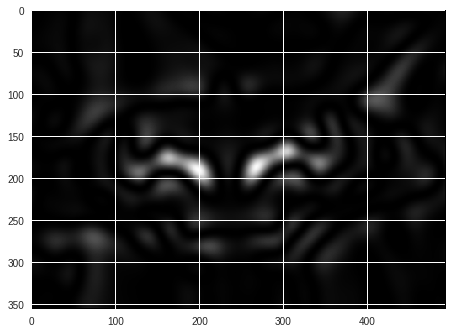

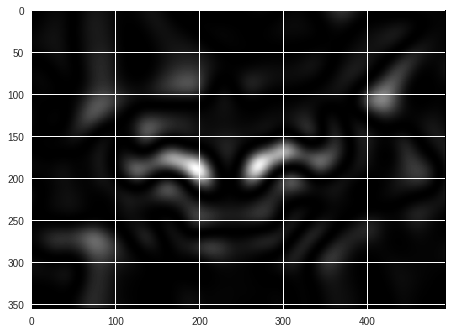

<Figure size 576x396 with 0 Axes>

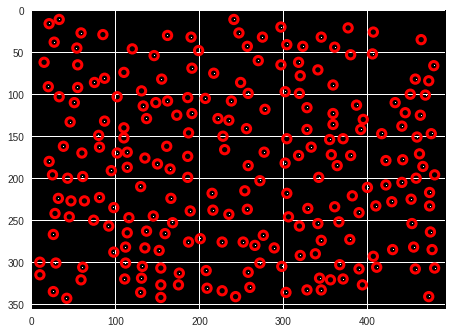

<Figure size 576x396 with 0 Axes>

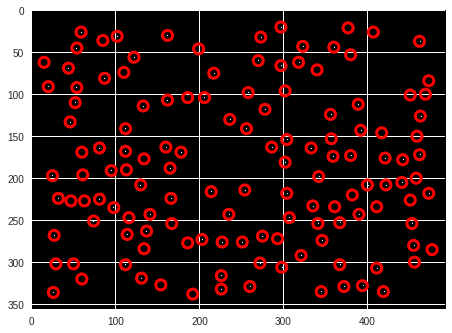

<Figure size 576x396 with 0 Axes>

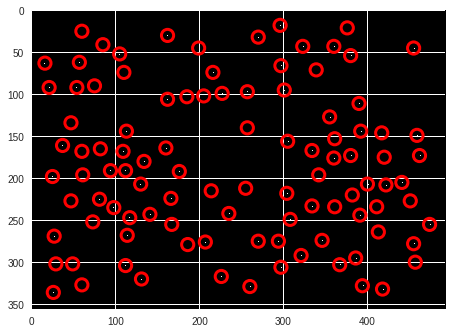

<Figure size 576x396 with 0 Axes>

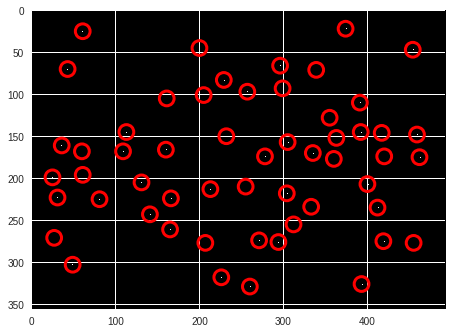

<Figure size 576x396 with 0 Axes>

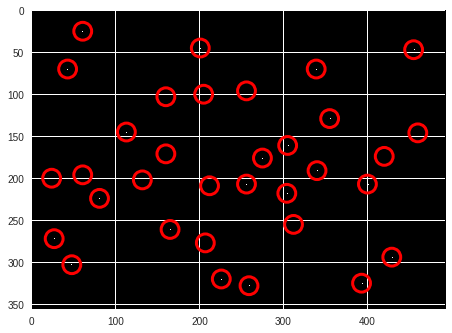

<Figure size 576x396 with 0 Axes>

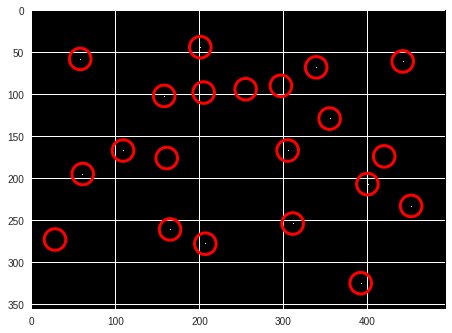

<Figure size 576x396 with 0 Axes>

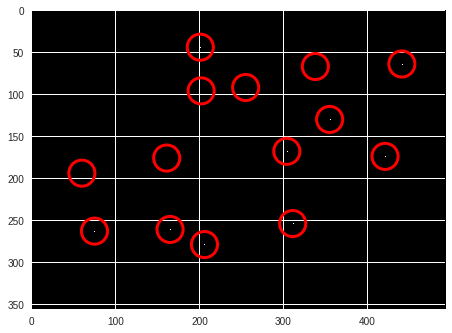

<Figure size 576x396 with 0 Axes>

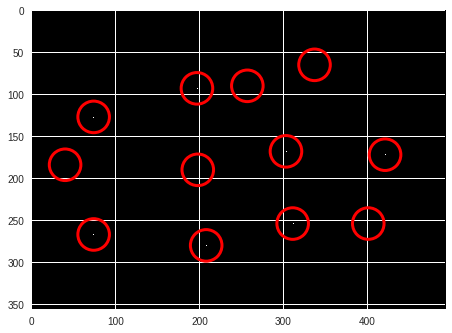

<Figure size 576x396 with 0 Axes>

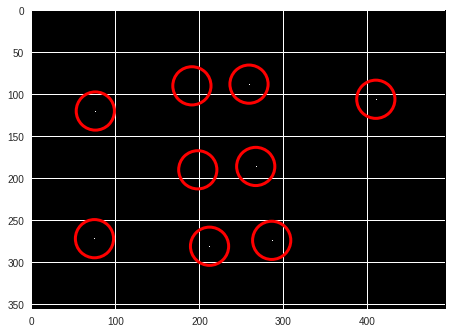

<Figure size 576x396 with 0 Axes>

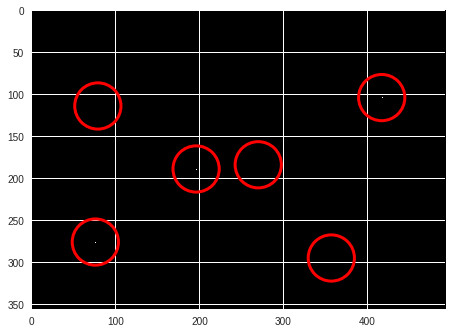

<Figure size 576x396 with 0 Axes>

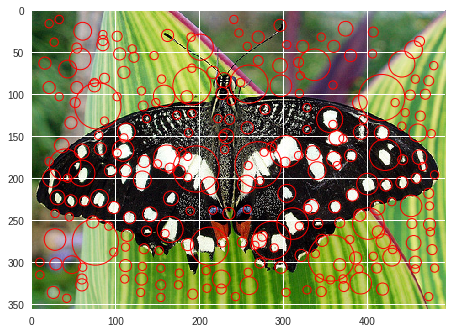

34.674816608428955


In [0]:
start = time.time()
n = 10
path = "butterfly.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image)
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

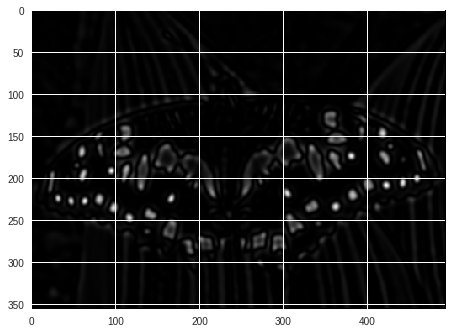

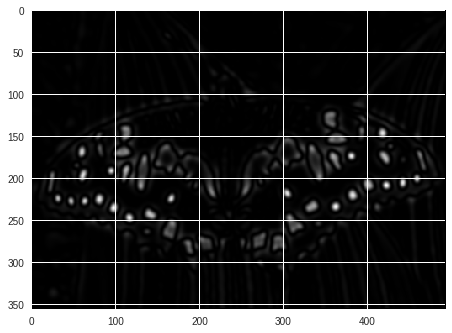

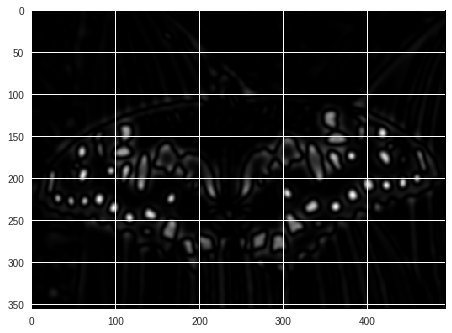

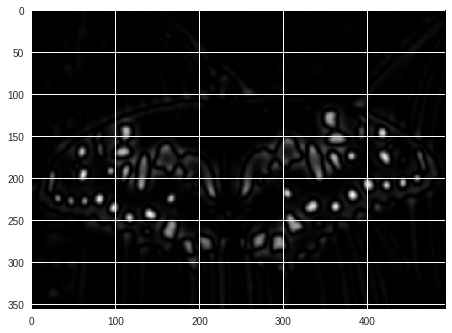

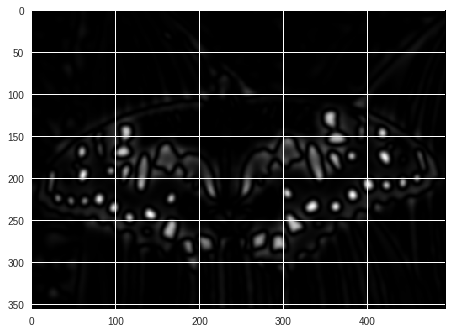

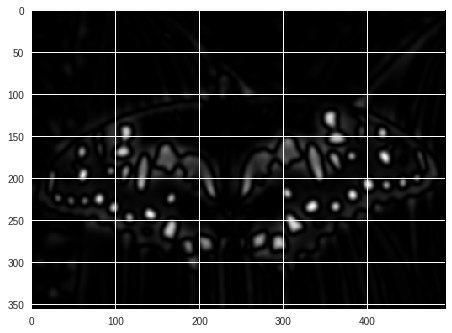

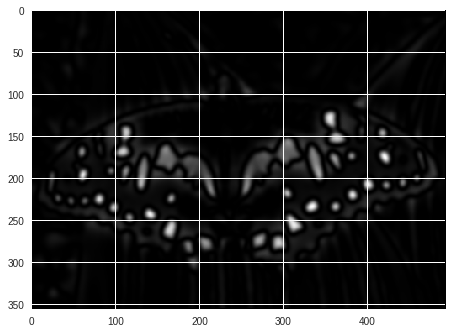

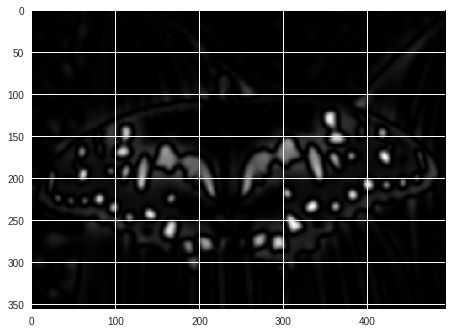

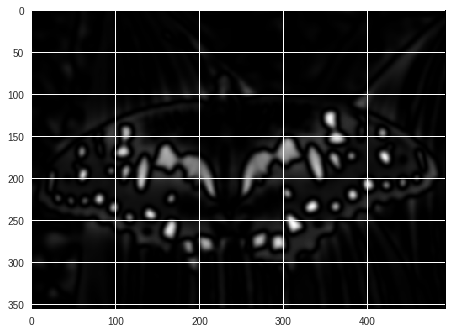

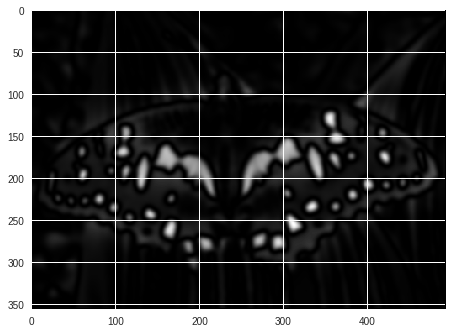

<Figure size 576x396 with 0 Axes>

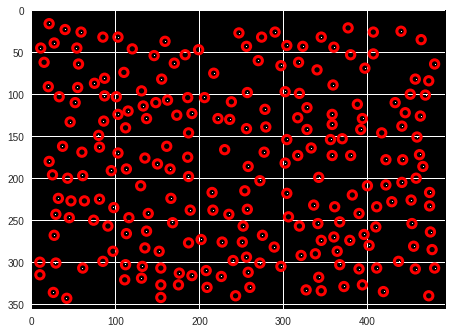

<Figure size 576x396 with 0 Axes>

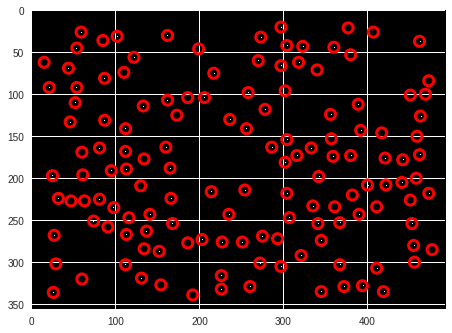

<Figure size 576x396 with 0 Axes>

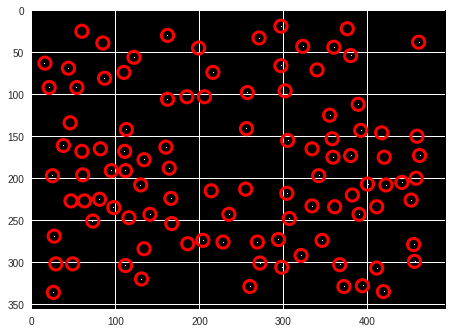

<Figure size 576x396 with 0 Axes>

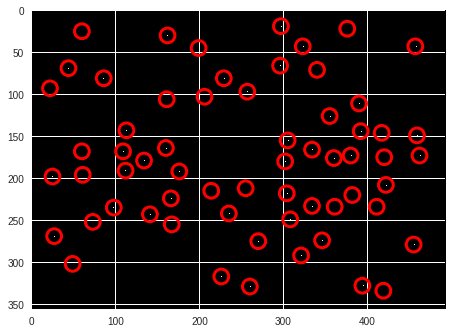

<Figure size 576x396 with 0 Axes>

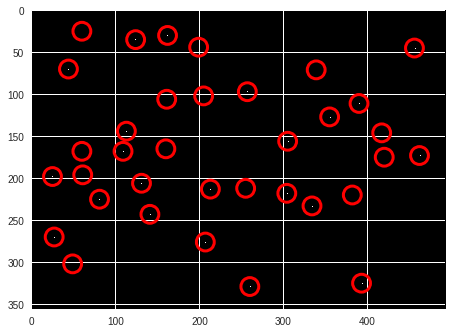

<Figure size 576x396 with 0 Axes>

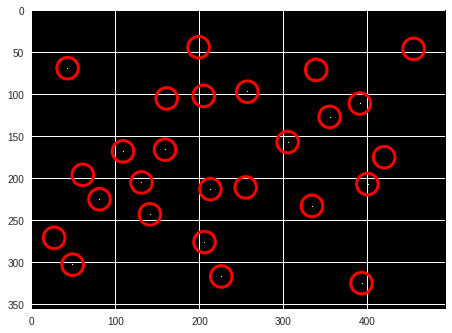

<Figure size 576x396 with 0 Axes>

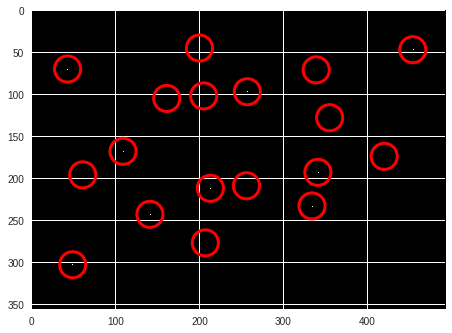

<Figure size 576x396 with 0 Axes>

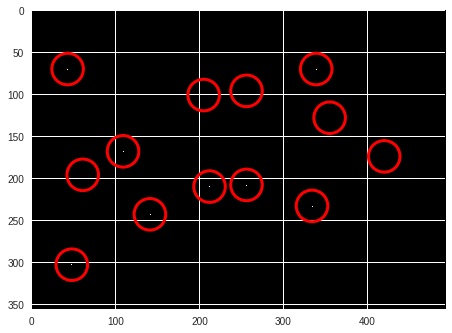

<Figure size 576x396 with 0 Axes>

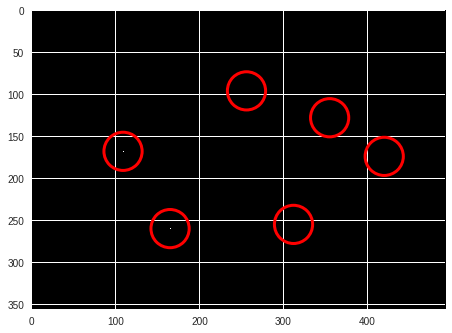

<Figure size 576x396 with 0 Axes>

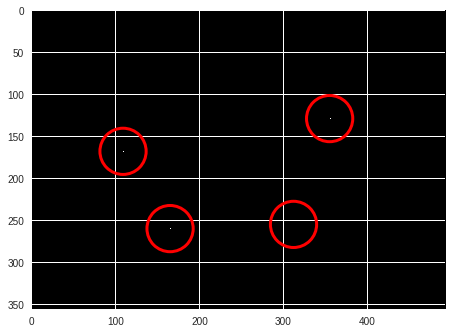

<Figure size 576x396 with 0 Axes>

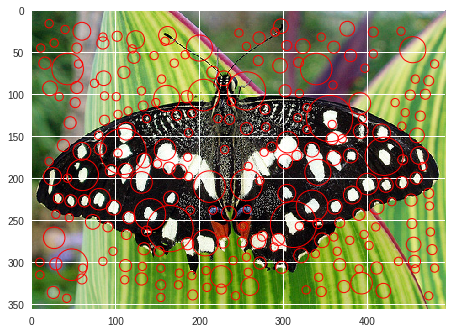

34.38932180404663


In [0]:
start = time.time()
n = 10
path = "butterfly.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

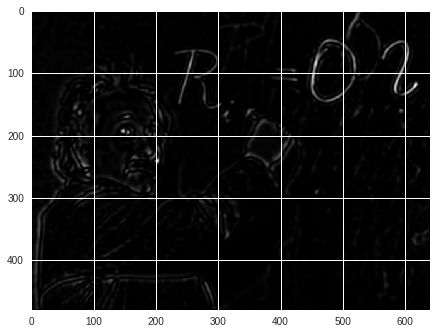

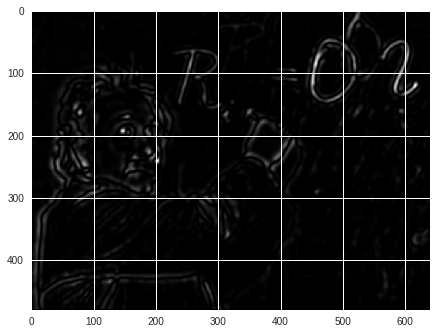

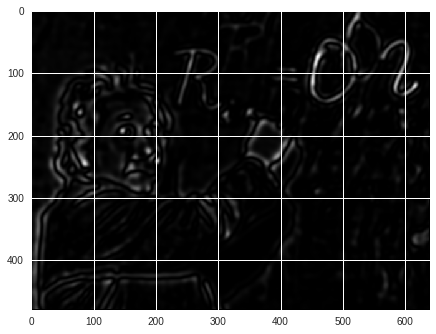

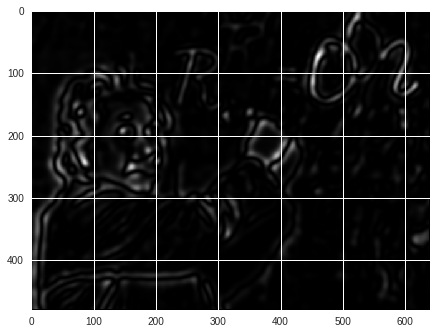

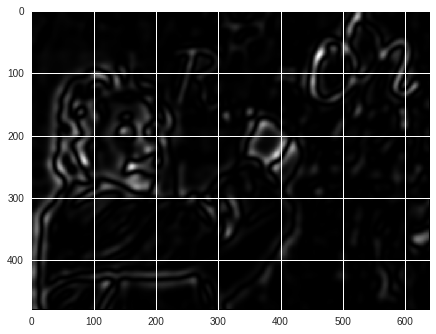

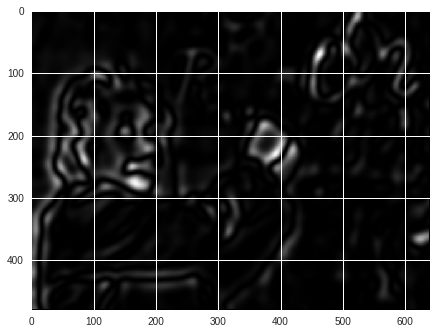

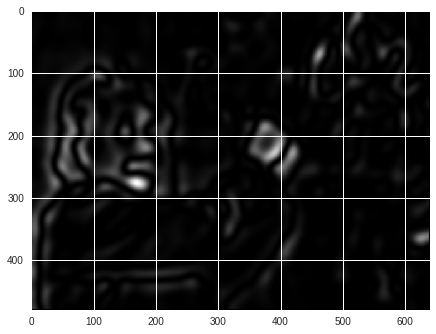

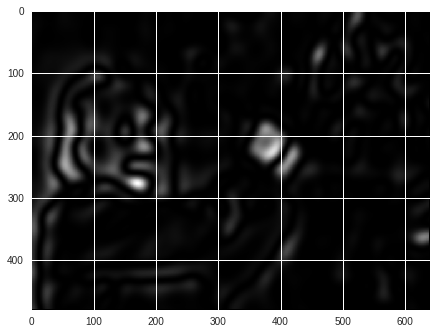

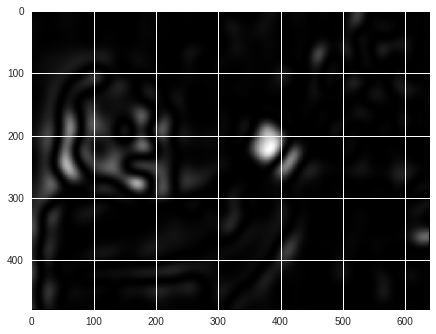

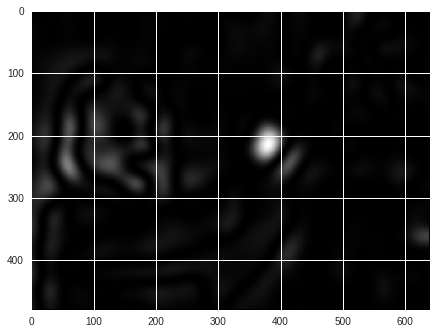

<Figure size 576x396 with 0 Axes>

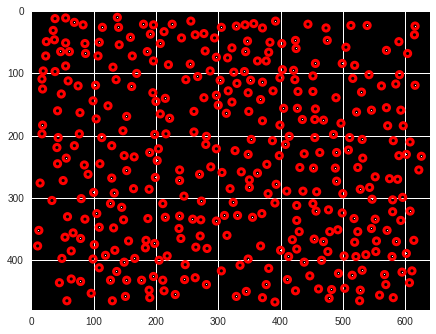

<Figure size 576x396 with 0 Axes>

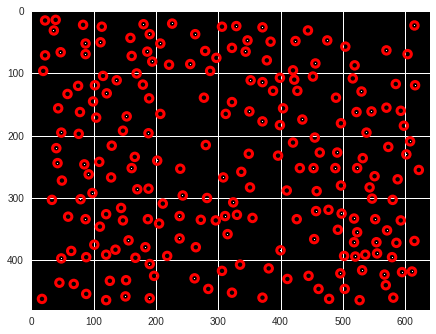

<Figure size 576x396 with 0 Axes>

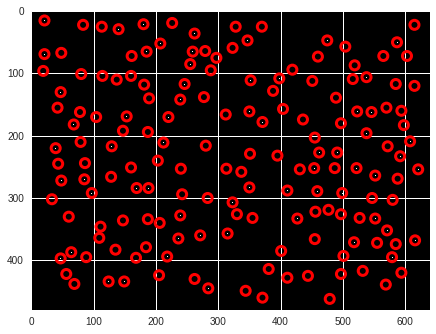

<Figure size 576x396 with 0 Axes>

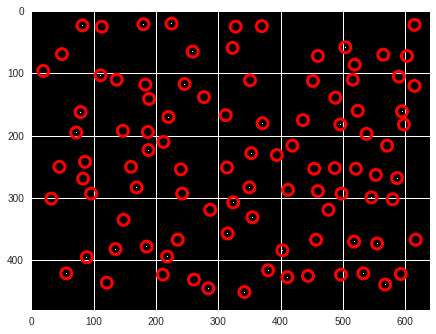

<Figure size 576x396 with 0 Axes>

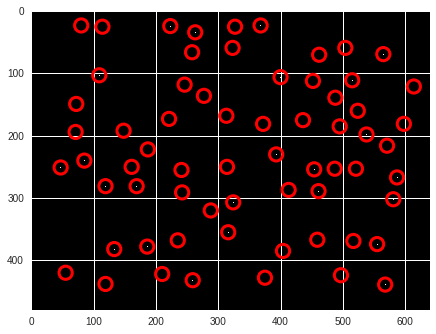

<Figure size 576x396 with 0 Axes>

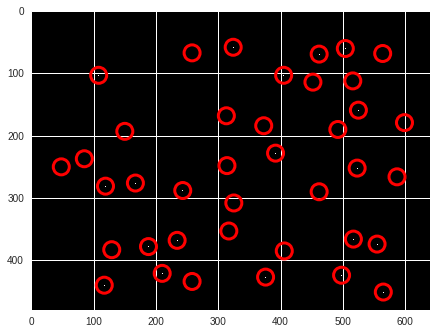

<Figure size 576x396 with 0 Axes>

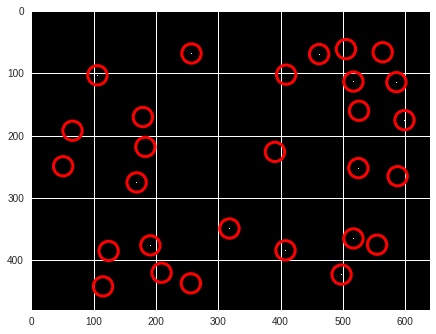

<Figure size 576x396 with 0 Axes>

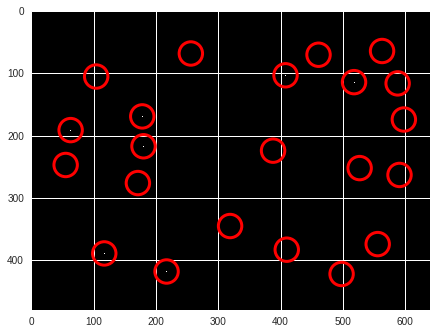

<Figure size 576x396 with 0 Axes>

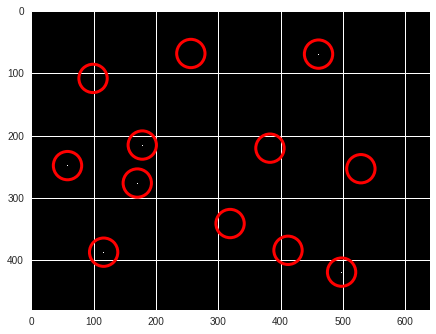

<Figure size 576x396 with 0 Axes>

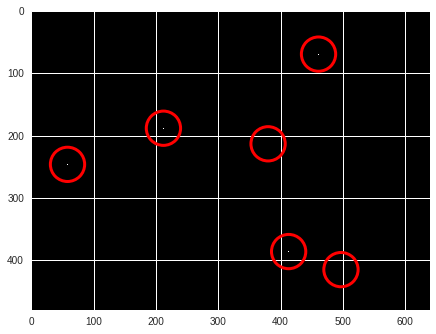

<Figure size 576x396 with 0 Axes>

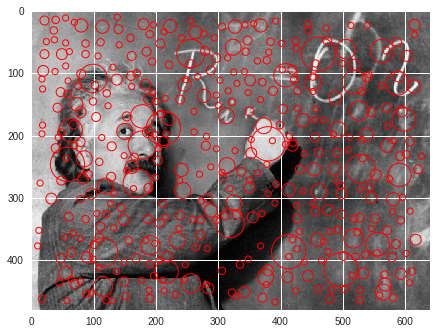

57.405301094055176


In [0]:
start = time.time()
n = 10
path = "einstein.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

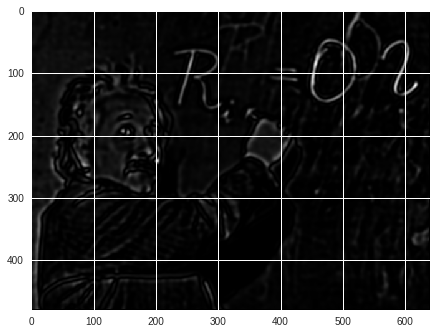

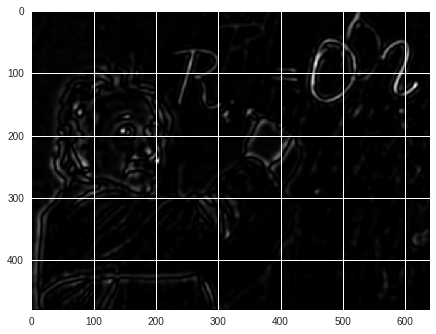

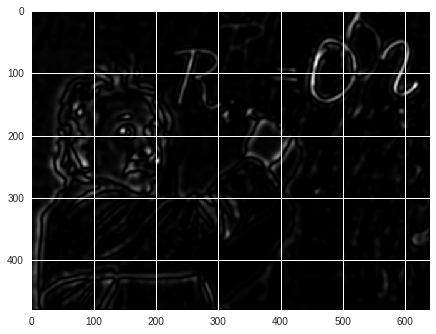

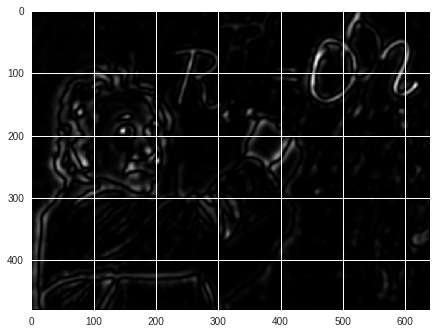

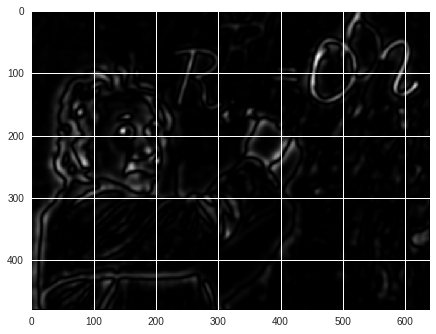

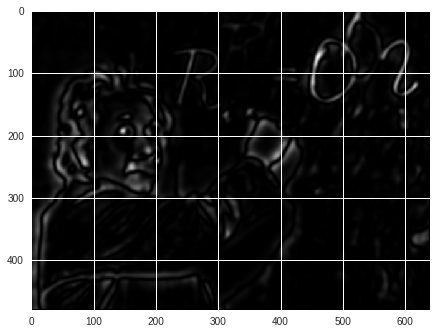

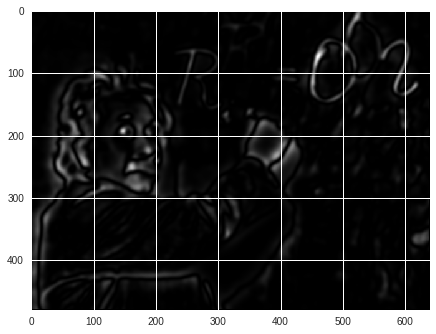

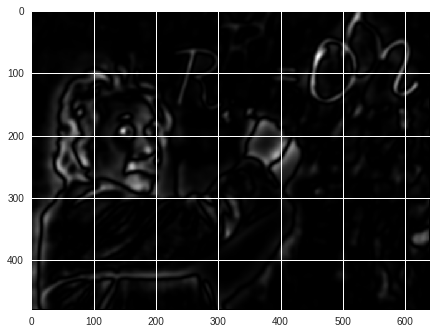

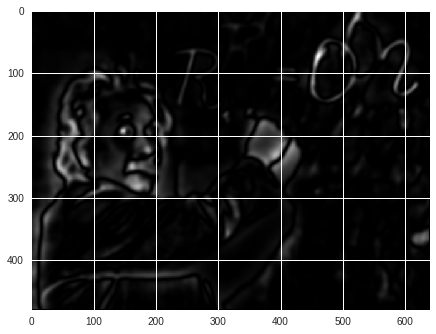

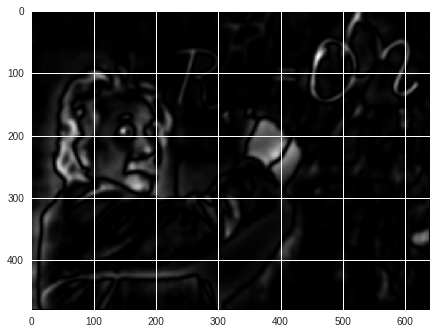

<Figure size 576x396 with 0 Axes>

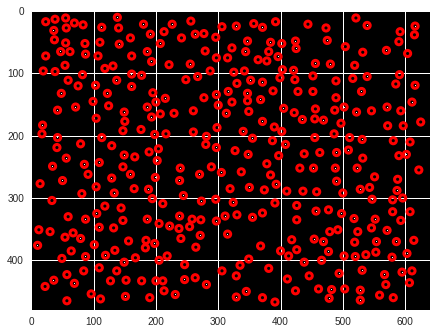

<Figure size 576x396 with 0 Axes>

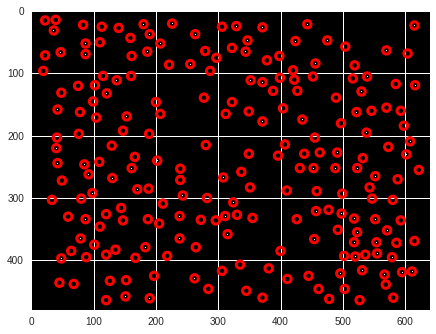

<Figure size 576x396 with 0 Axes>

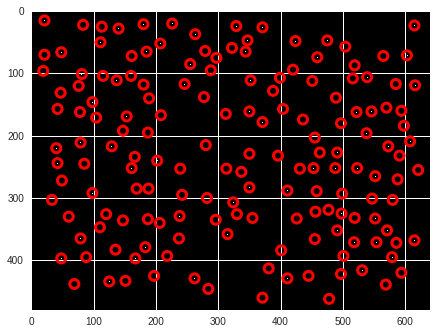

<Figure size 576x396 with 0 Axes>

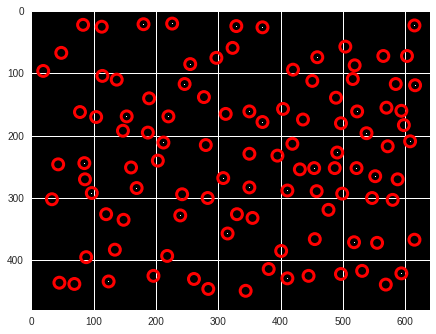

<Figure size 576x396 with 0 Axes>

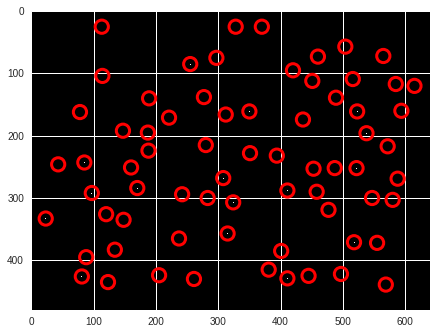

<Figure size 576x396 with 0 Axes>

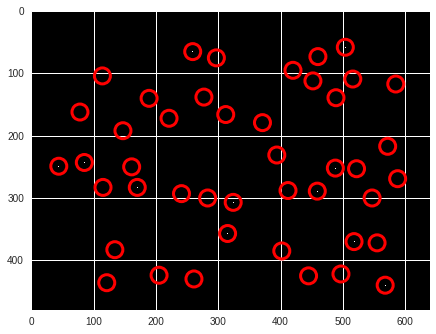

<Figure size 576x396 with 0 Axes>

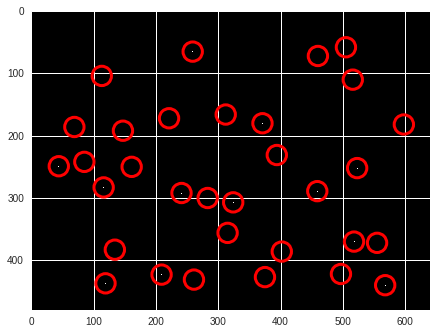

<Figure size 576x396 with 0 Axes>

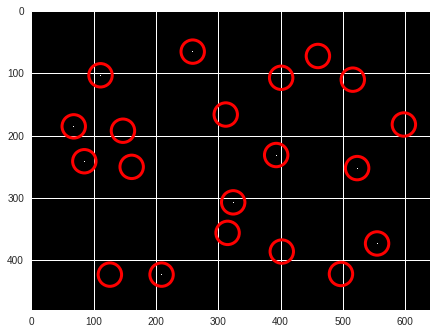

<Figure size 576x396 with 0 Axes>

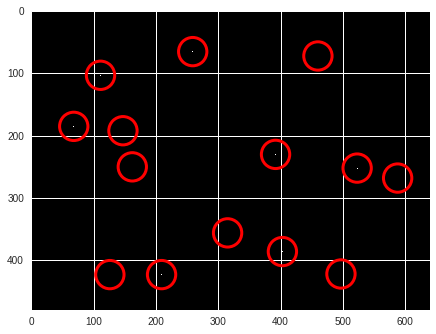

<Figure size 576x396 with 0 Axes>

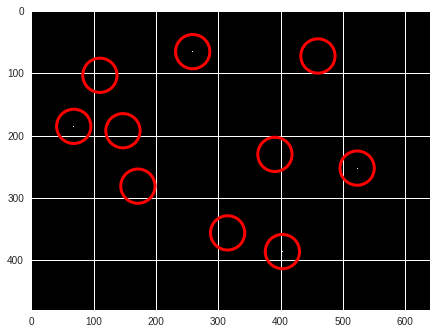

<Figure size 576x396 with 0 Axes>

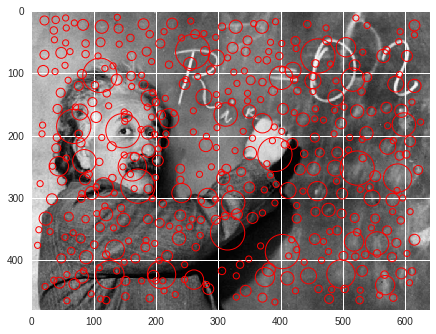

57.869709968566895


In [0]:
start = time.time()
n = 10
path = "einstein.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

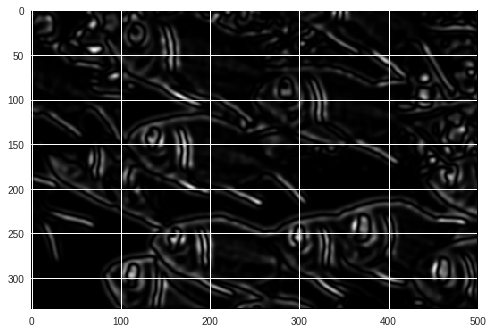

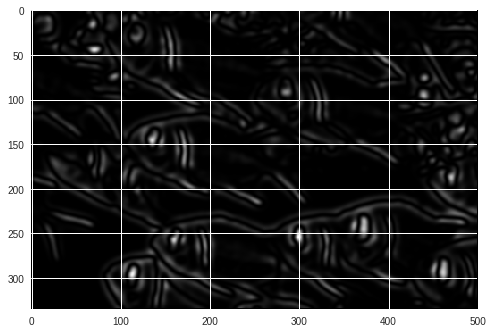

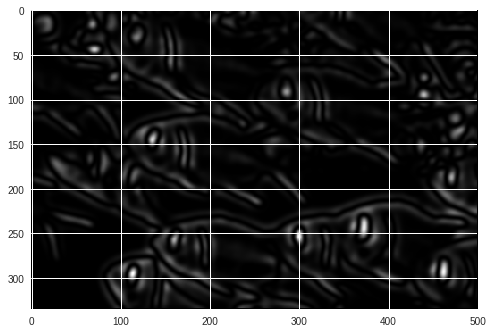

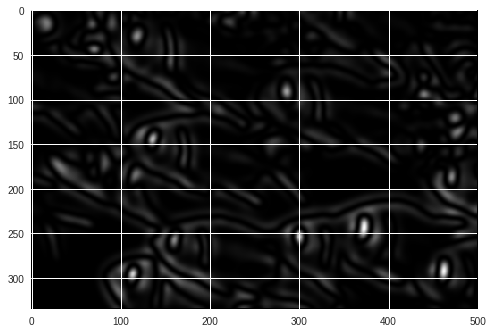

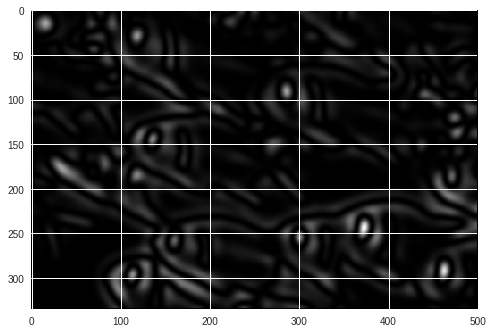

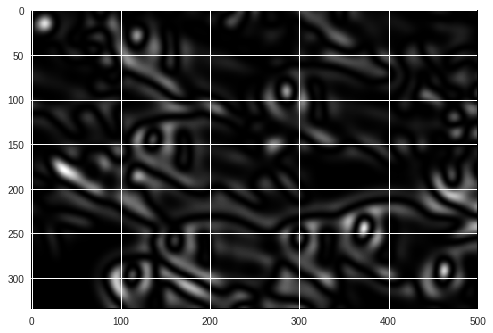

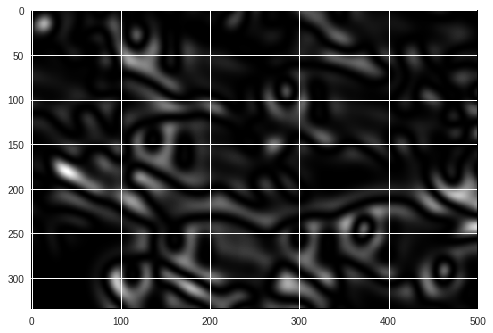

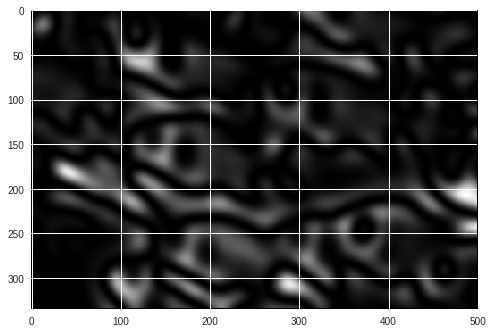

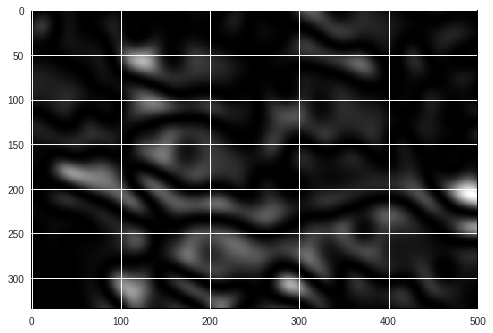

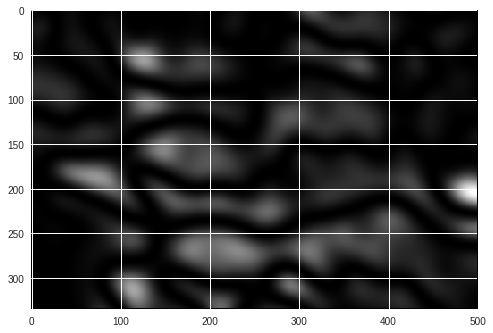

<Figure size 576x396 with 0 Axes>

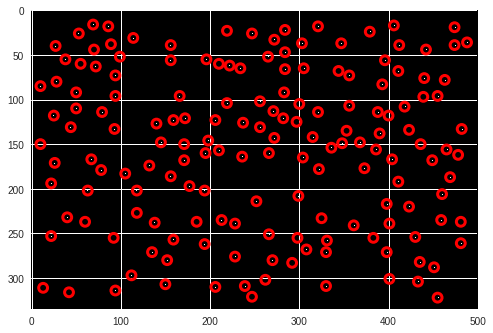

<Figure size 576x396 with 0 Axes>

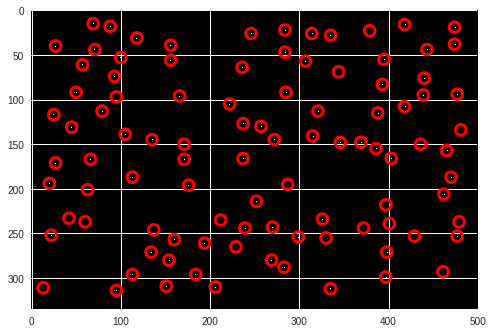

<Figure size 576x396 with 0 Axes>

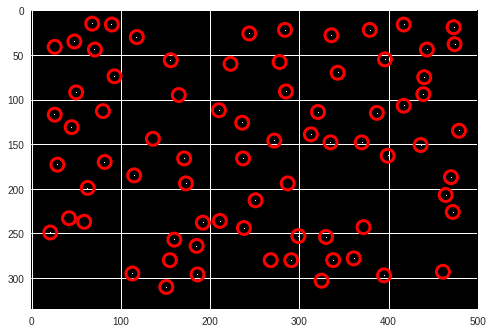

<Figure size 576x396 with 0 Axes>

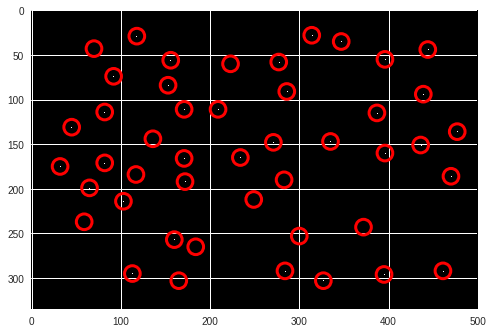

<Figure size 576x396 with 0 Axes>

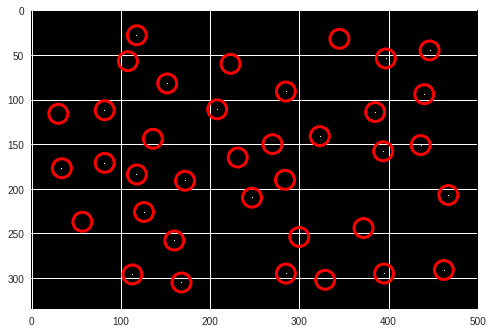

<Figure size 576x396 with 0 Axes>

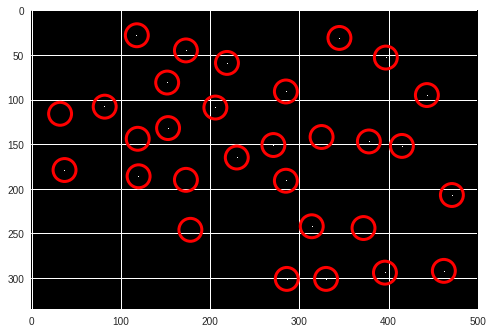

<Figure size 576x396 with 0 Axes>

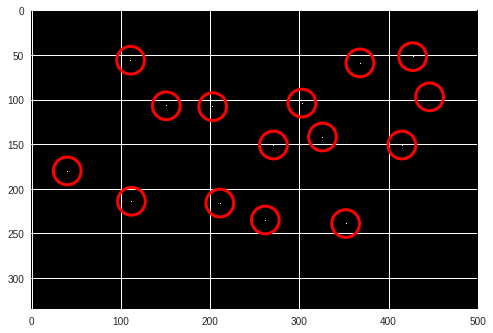

<Figure size 576x396 with 0 Axes>

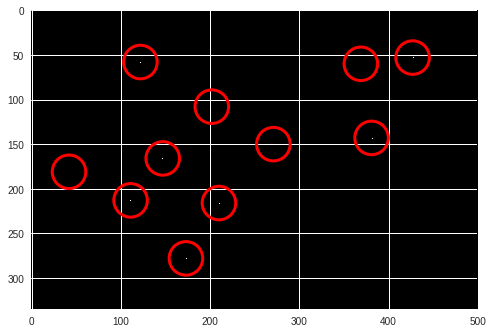

<Figure size 576x396 with 0 Axes>

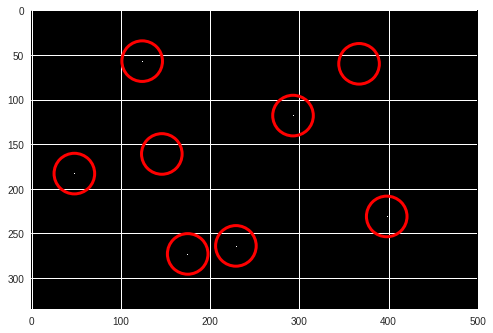

<Figure size 576x396 with 0 Axes>

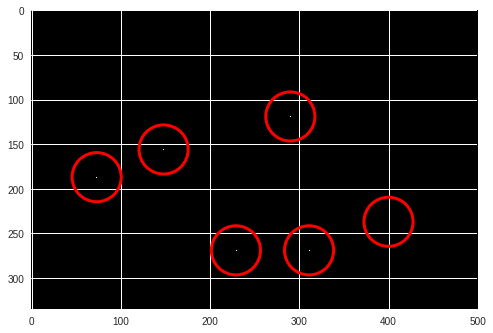

<Figure size 576x396 with 0 Axes>

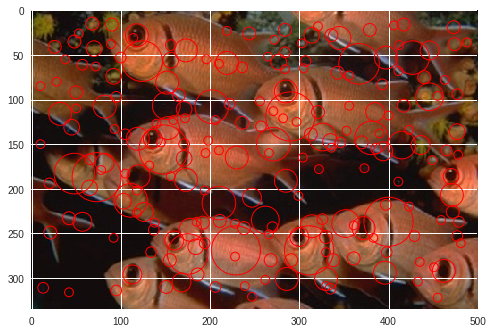

33.20057916641235


In [0]:
start = time.time()
n = 10
path = "fishes.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

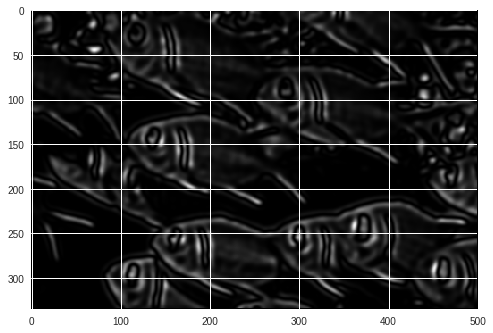

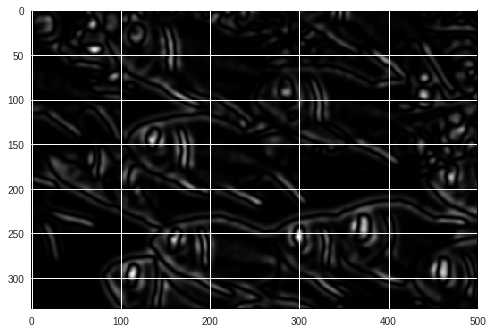

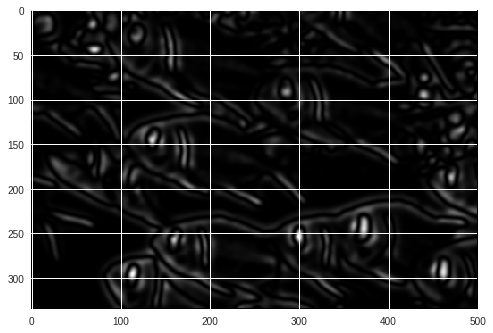

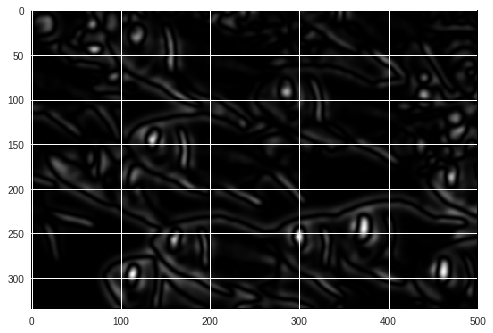

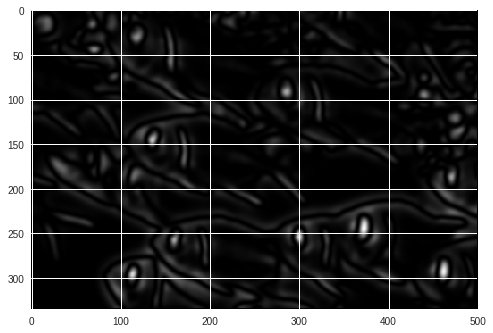

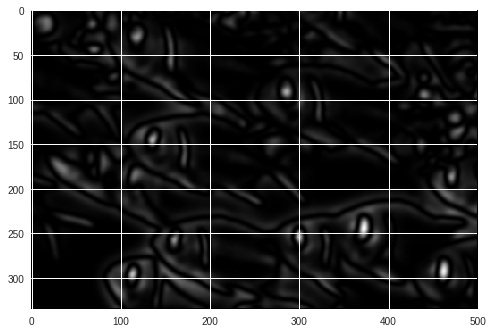

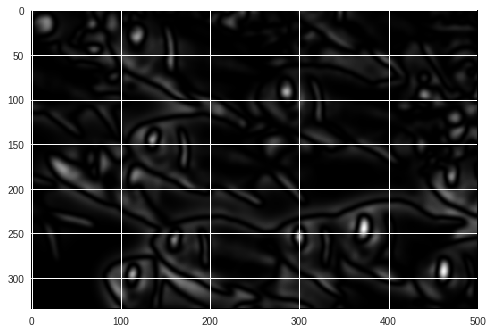

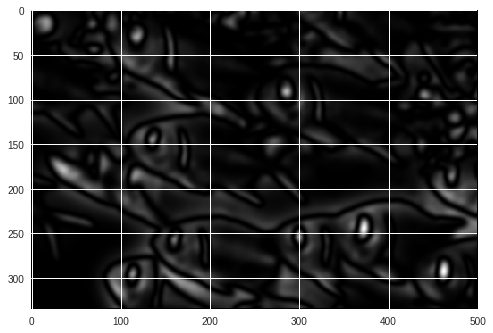

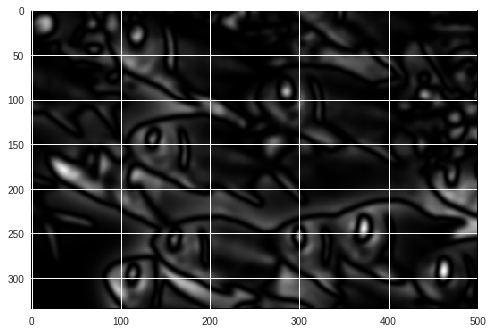

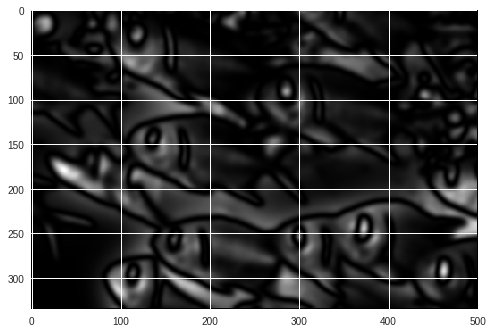

<Figure size 576x396 with 0 Axes>

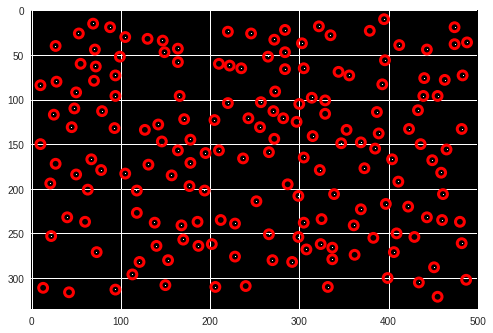

<Figure size 576x396 with 0 Axes>

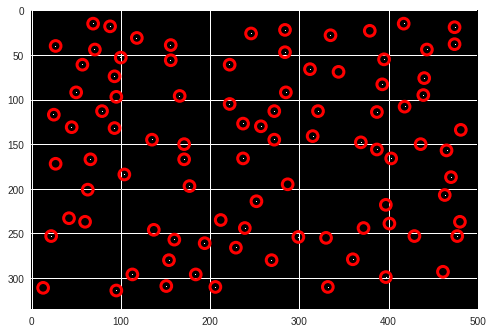

<Figure size 576x396 with 0 Axes>

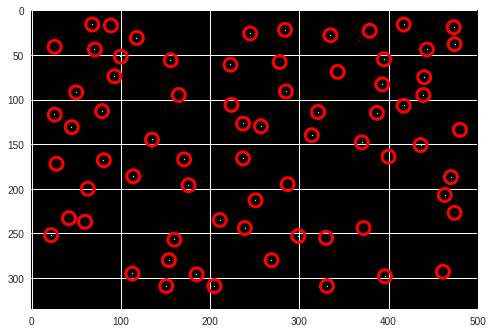

<Figure size 576x396 with 0 Axes>

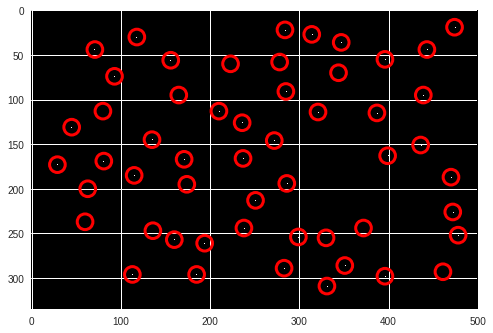

<Figure size 576x396 with 0 Axes>

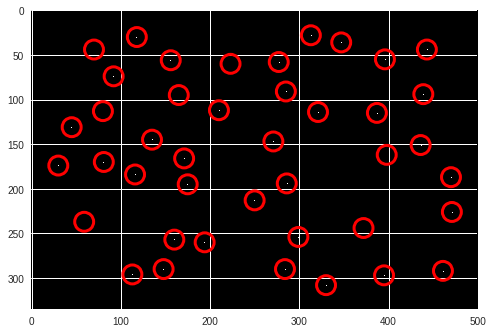

<Figure size 576x396 with 0 Axes>

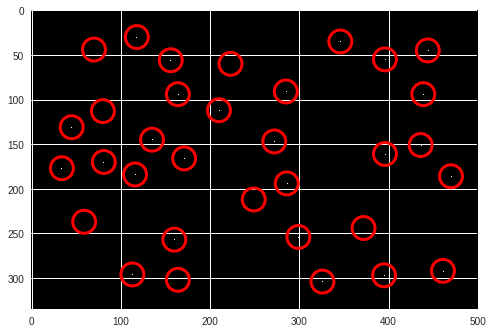

<Figure size 576x396 with 0 Axes>

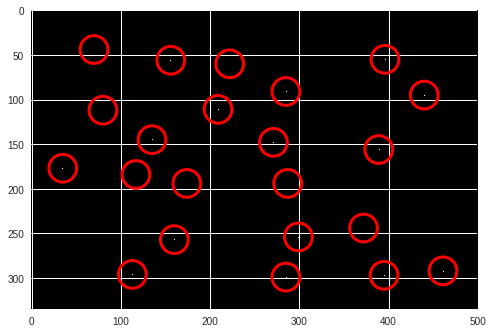

<Figure size 576x396 with 0 Axes>

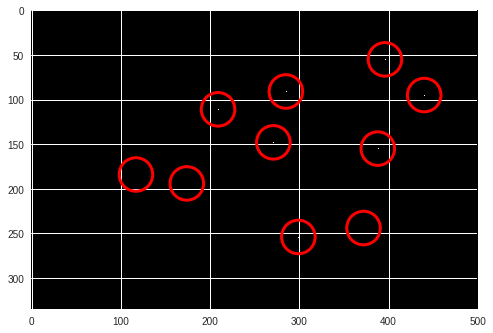

<Figure size 576x396 with 0 Axes>

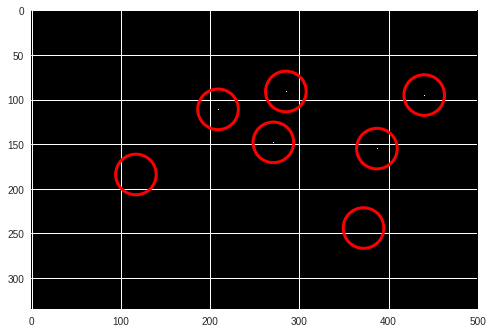

<Figure size 576x396 with 0 Axes>

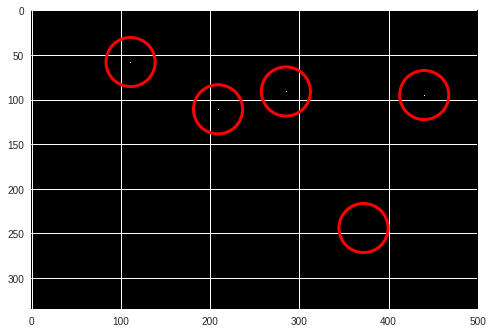

<Figure size 576x396 with 0 Axes>

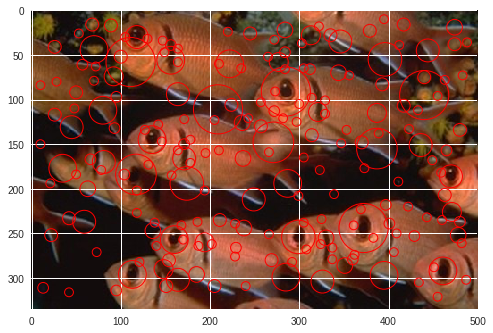

33.29722452163696


In [0]:
start = time.time()
n = 10
path = "fishes.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

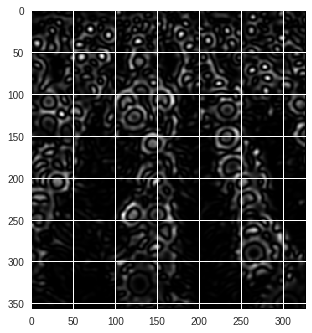

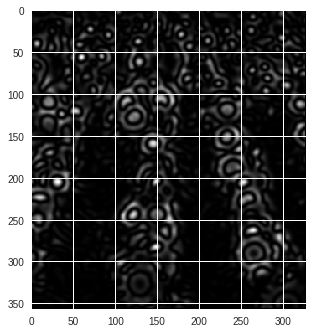

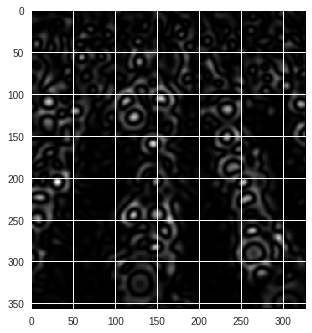

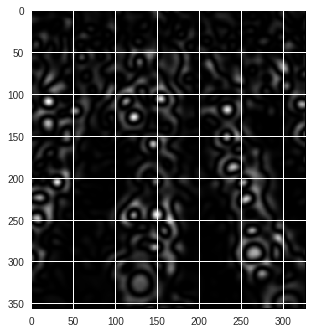

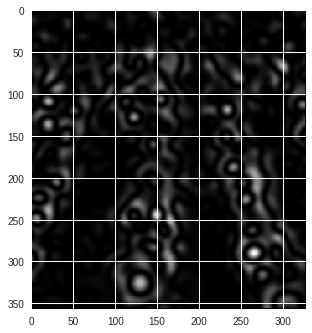

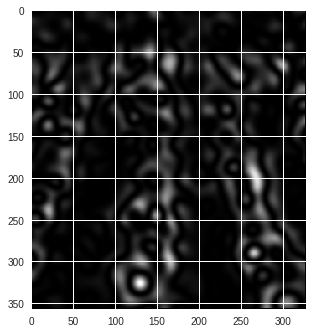

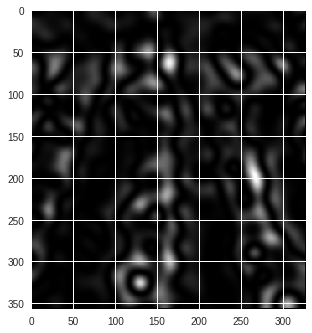

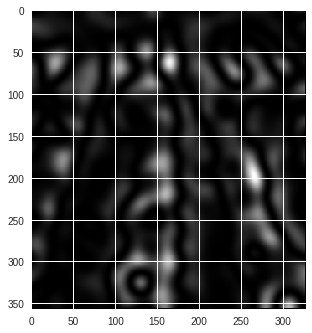

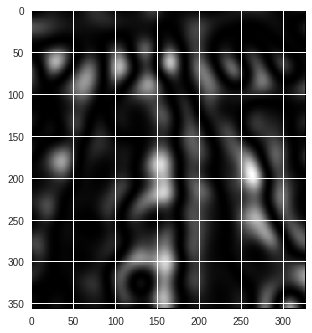

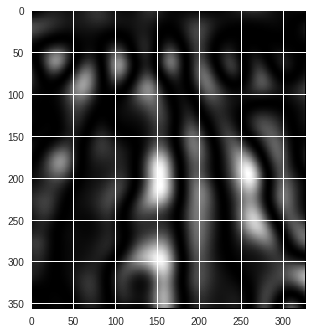

<Figure size 576x396 with 0 Axes>

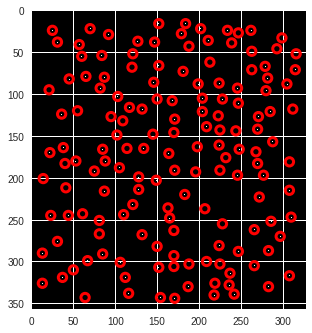

<Figure size 576x396 with 0 Axes>

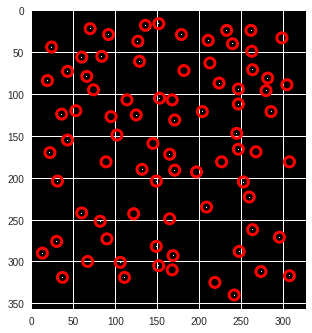

<Figure size 576x396 with 0 Axes>

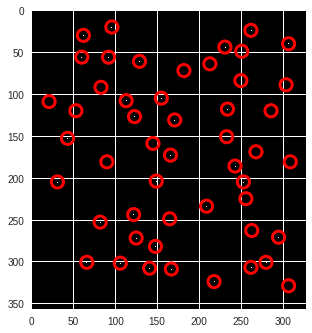

<Figure size 576x396 with 0 Axes>

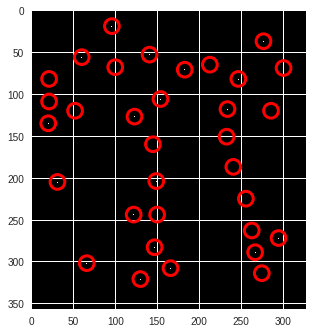

<Figure size 576x396 with 0 Axes>

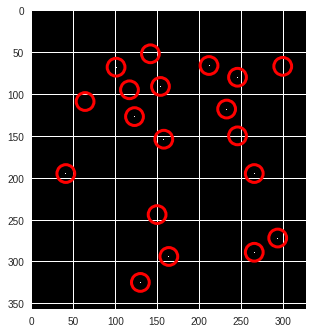

<Figure size 576x396 with 0 Axes>

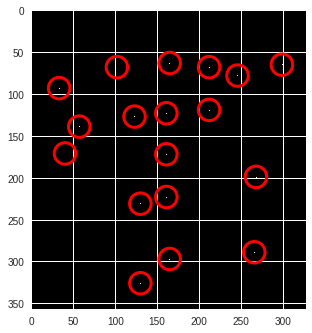

<Figure size 576x396 with 0 Axes>

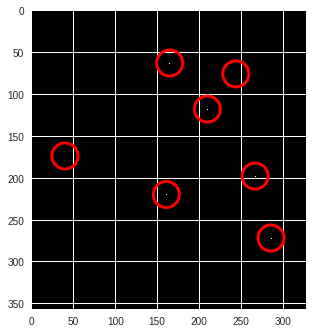

<Figure size 576x396 with 0 Axes>

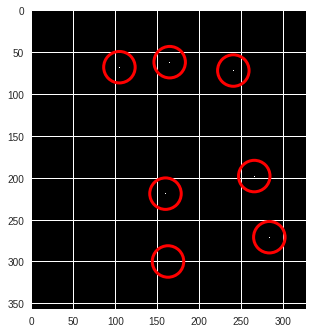

<Figure size 576x396 with 0 Axes>

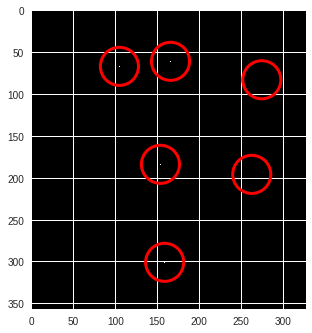

<Figure size 576x396 with 0 Axes>

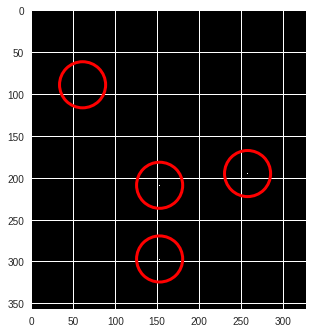

<Figure size 576x396 with 0 Axes>

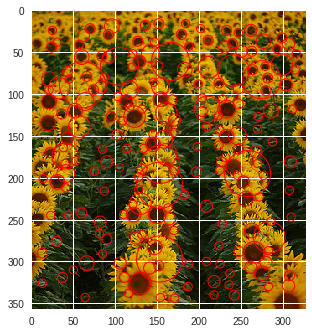

24.47645902633667


In [0]:
start = time.time()
n = 10
path = "sunflowers.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

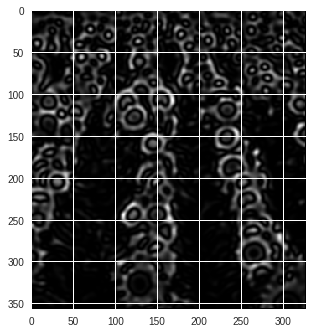

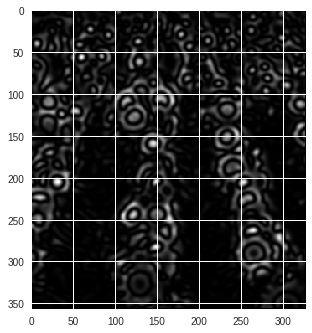

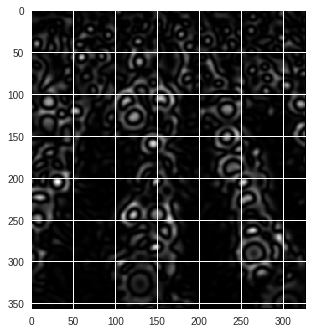

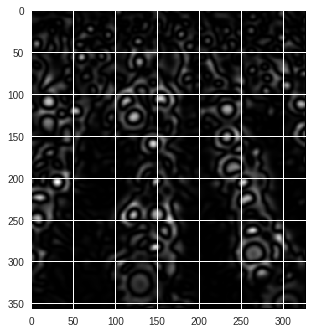

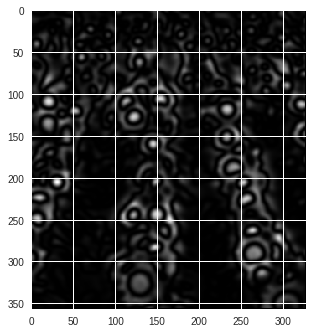

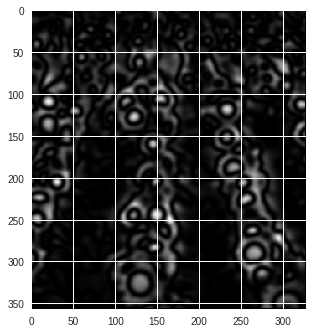

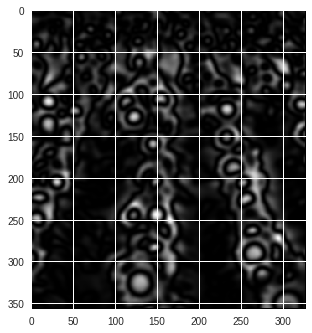

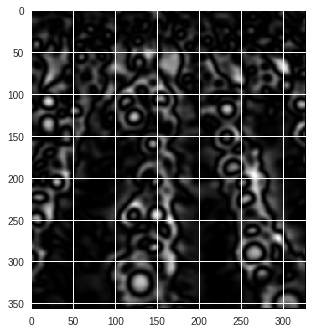

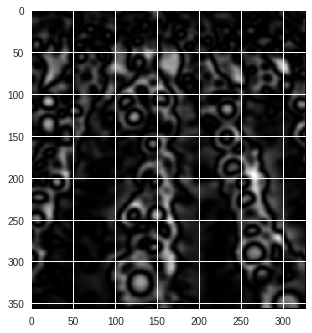

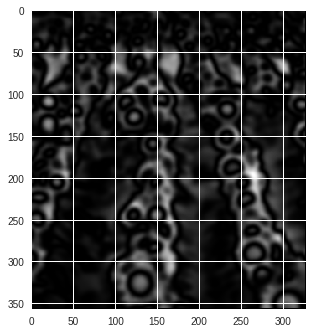

<Figure size 576x396 with 0 Axes>

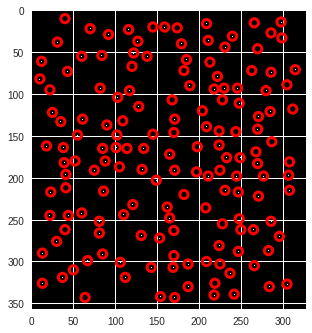

<Figure size 576x396 with 0 Axes>

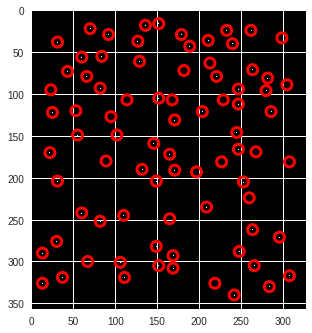

<Figure size 576x396 with 0 Axes>

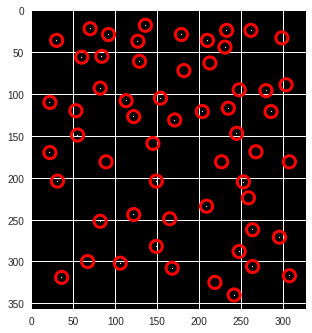

<Figure size 576x396 with 0 Axes>

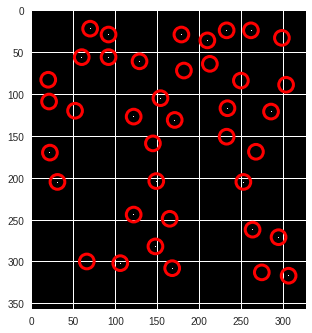

<Figure size 576x396 with 0 Axes>

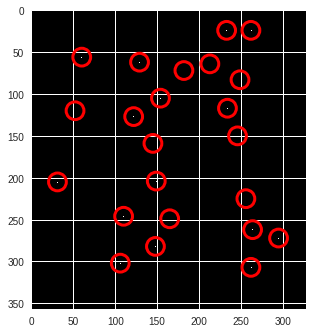

<Figure size 576x396 with 0 Axes>

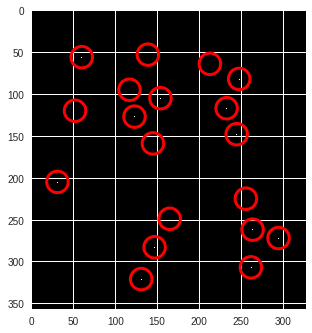

<Figure size 576x396 with 0 Axes>

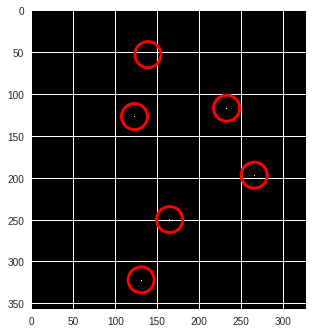

<Figure size 576x396 with 0 Axes>

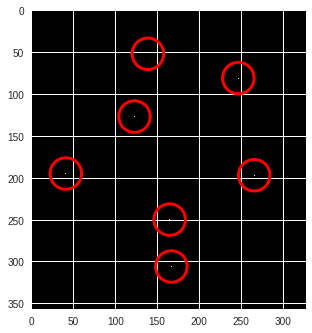

<Figure size 576x396 with 0 Axes>

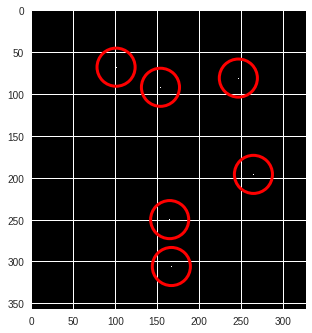

<Figure size 576x396 with 0 Axes>

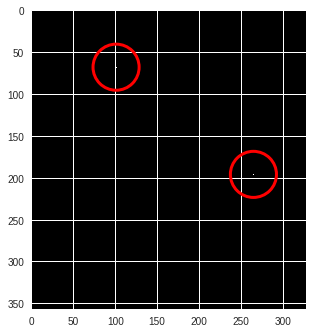

<Figure size 576x396 with 0 Axes>

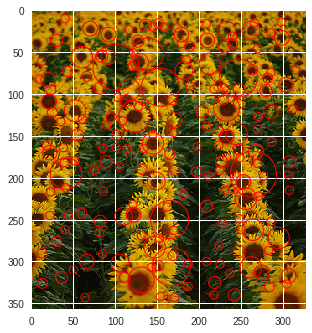

24.39238691329956


In [0]:
start = time.time()
n = 10
path = "sunflowers.jpg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

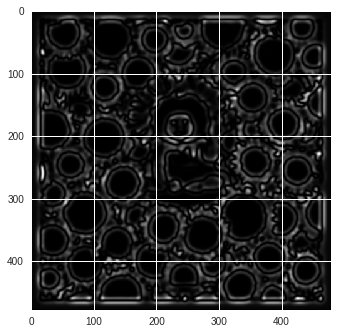

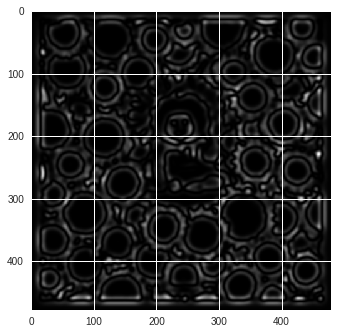

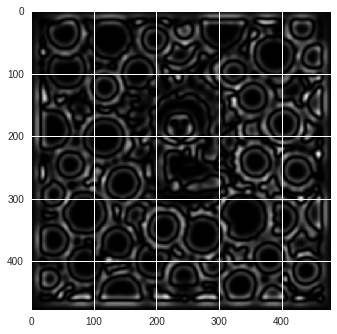

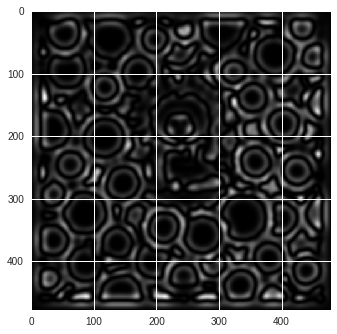

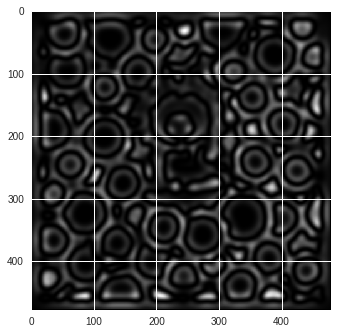

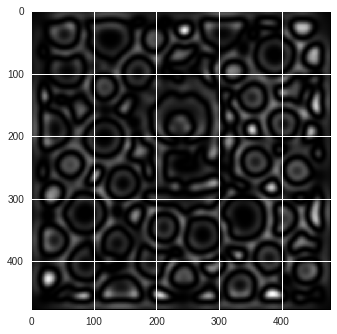

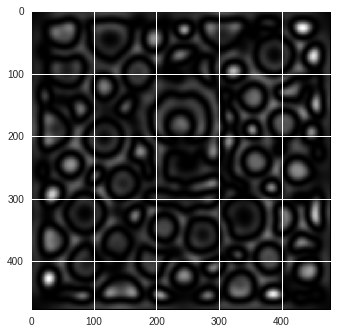

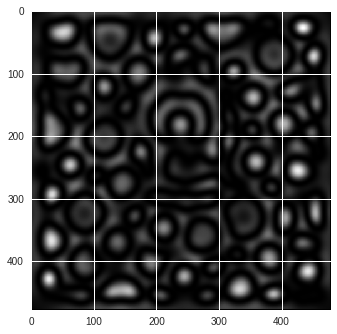

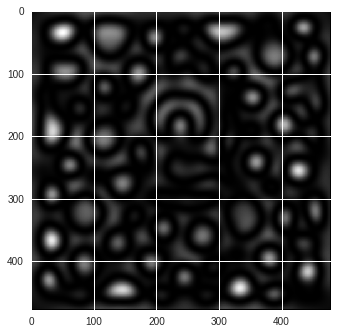

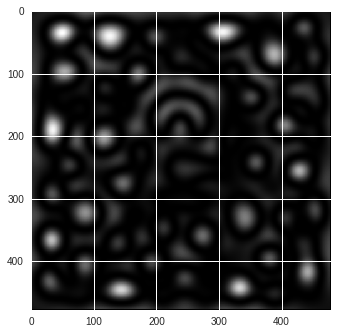

<Figure size 576x396 with 0 Axes>

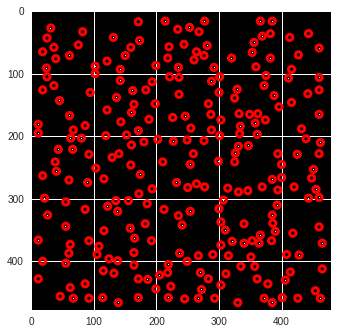

<Figure size 576x396 with 0 Axes>

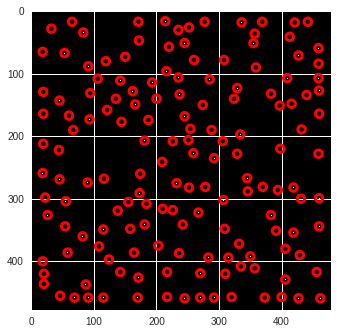

<Figure size 576x396 with 0 Axes>

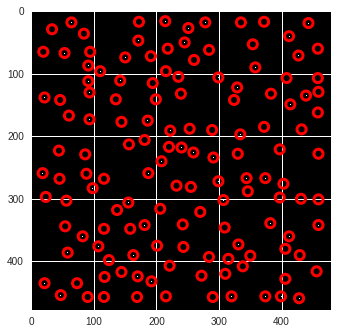

<Figure size 576x396 with 0 Axes>

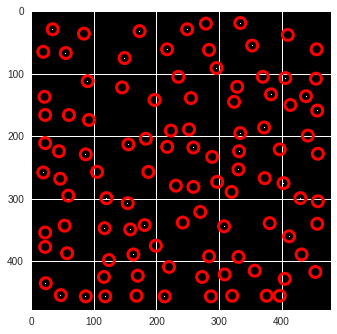

<Figure size 576x396 with 0 Axes>

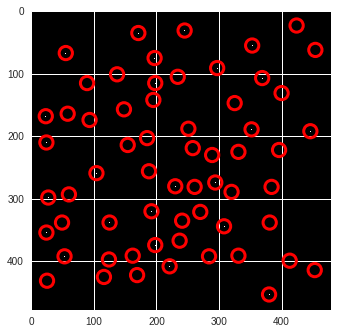

<Figure size 576x396 with 0 Axes>

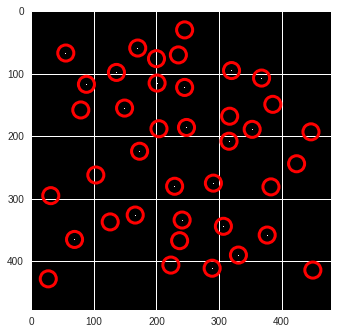

<Figure size 576x396 with 0 Axes>

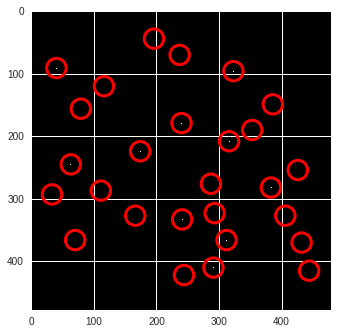

<Figure size 576x396 with 0 Axes>

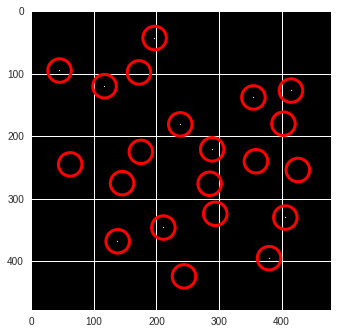

<Figure size 576x396 with 0 Axes>

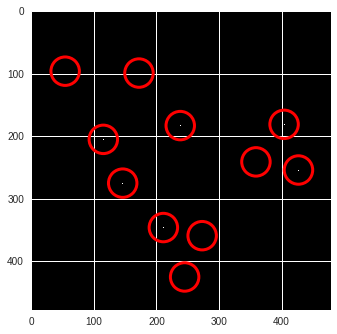

<Figure size 576x396 with 0 Axes>

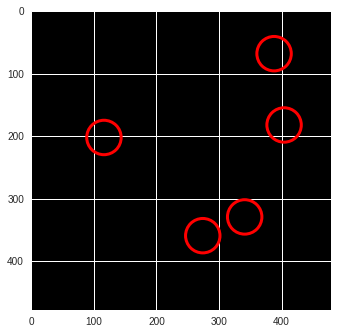

<Figure size 576x396 with 0 Axes>

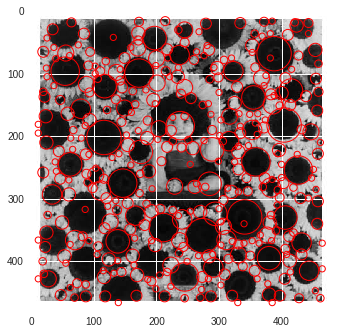

43.549209117889404


In [0]:
start = time.time()
n = 10
path = "flowers.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

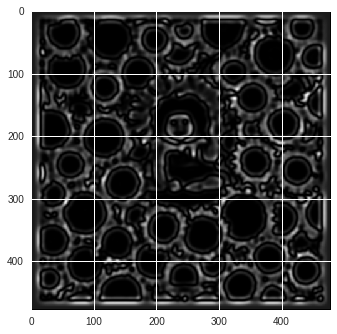

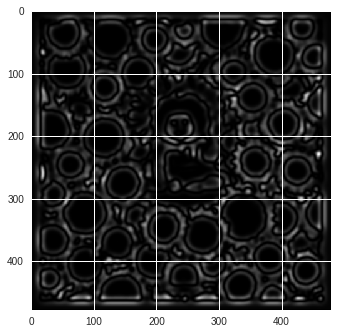

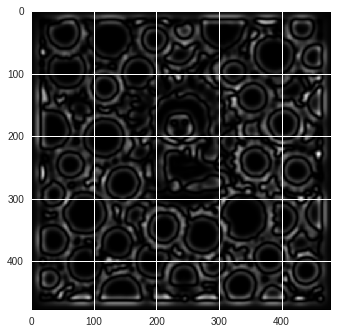

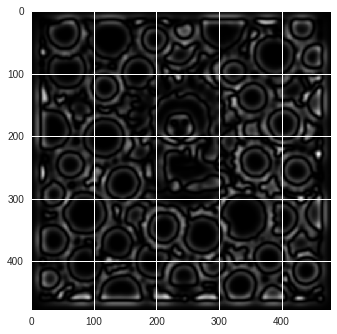

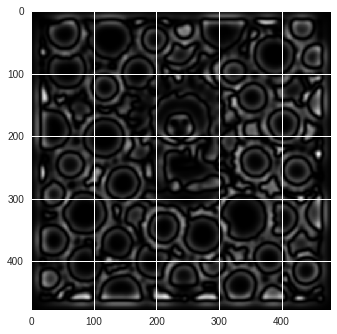

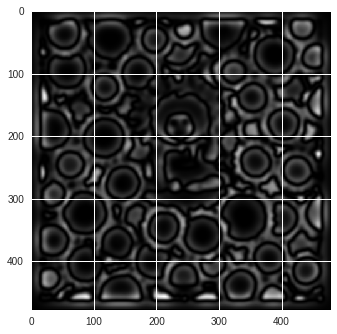

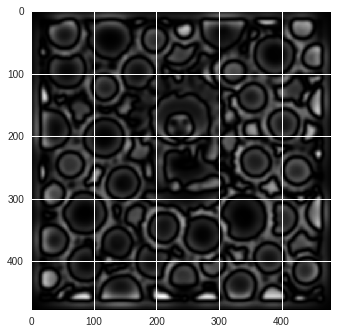

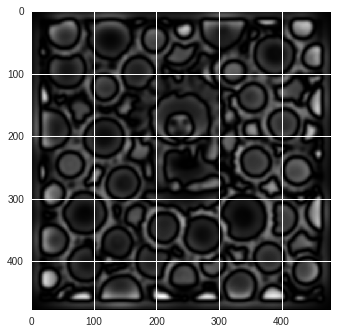

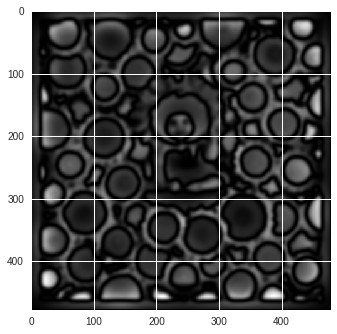

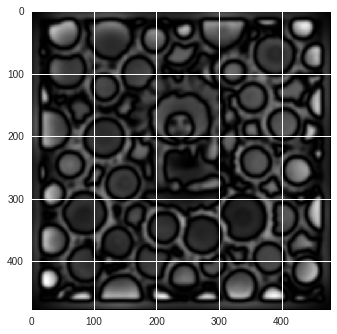

<Figure size 576x396 with 0 Axes>

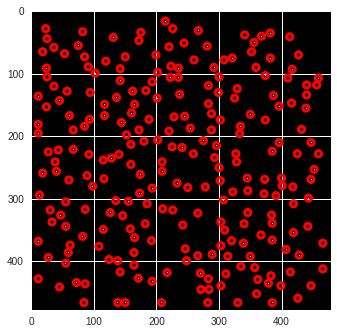

<Figure size 576x396 with 0 Axes>

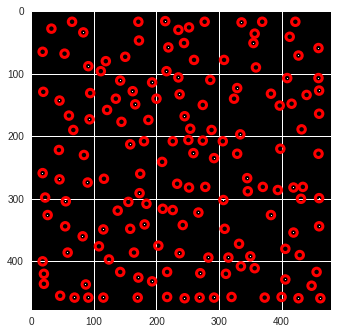

<Figure size 576x396 with 0 Axes>

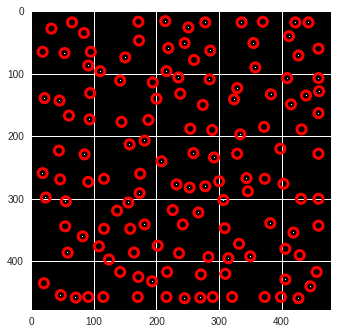

<Figure size 576x396 with 0 Axes>

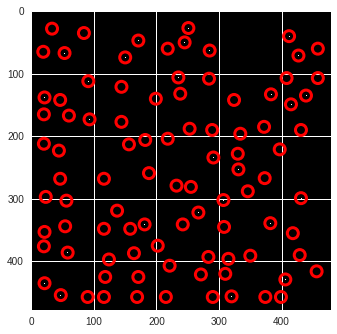

<Figure size 576x396 with 0 Axes>

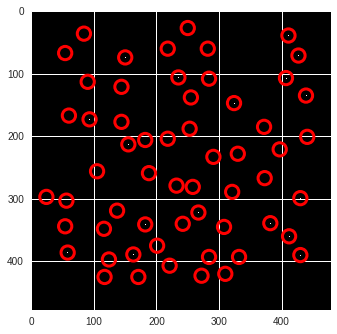

<Figure size 576x396 with 0 Axes>

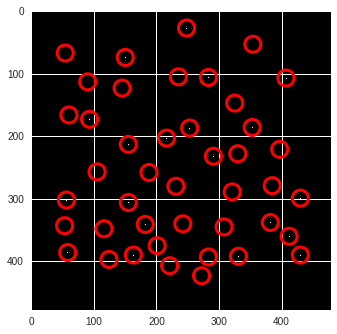

<Figure size 576x396 with 0 Axes>

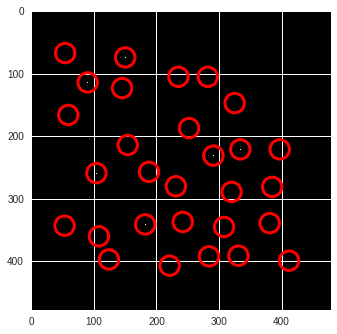

<Figure size 576x396 with 0 Axes>

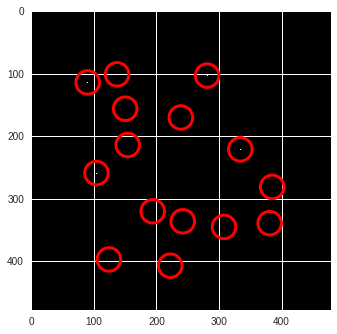

<Figure size 576x396 with 0 Axes>

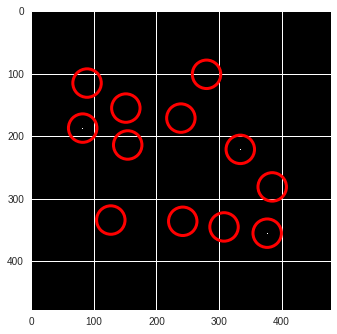

<Figure size 576x396 with 0 Axes>

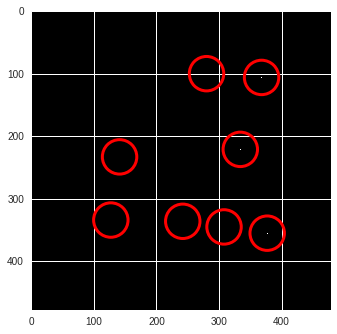

<Figure size 576x396 with 0 Axes>

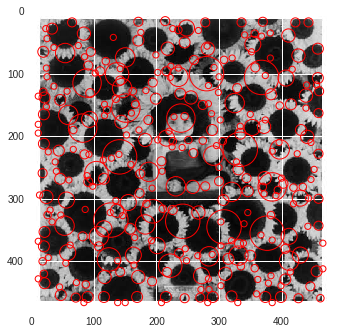

43.62589621543884


In [0]:
start = time.time()
n = 10
path = "flowers.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

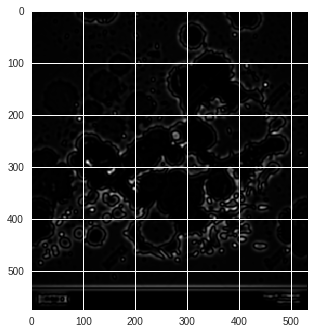

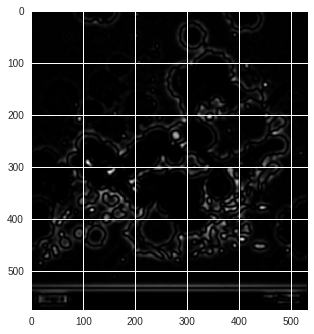

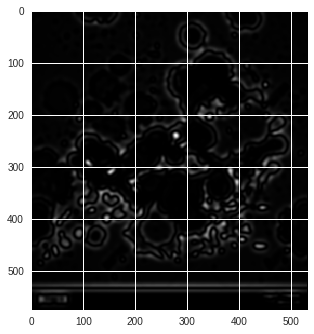

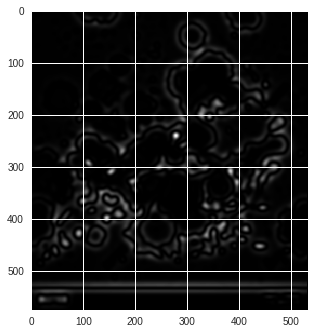

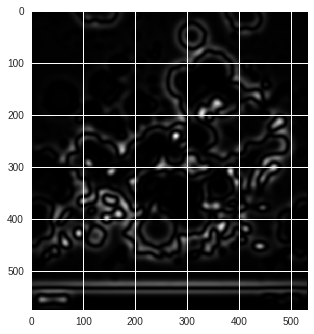

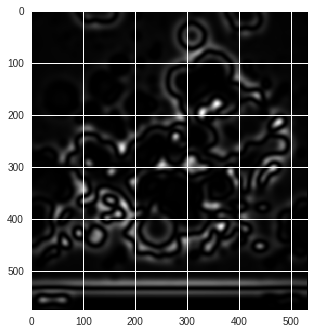

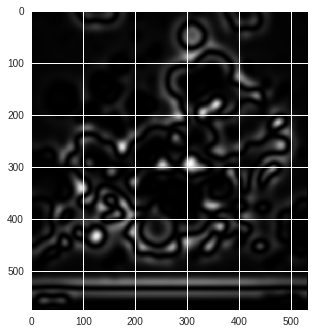

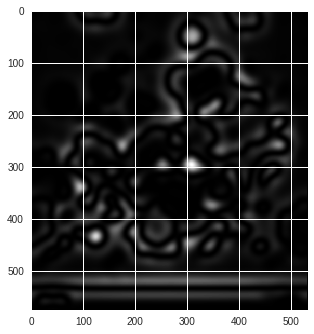

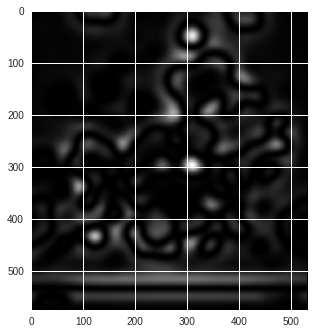

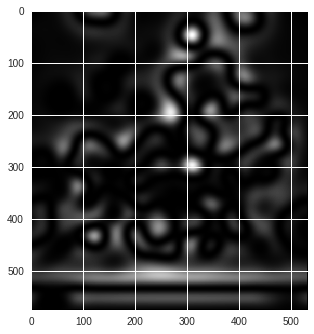

<Figure size 576x396 with 0 Axes>

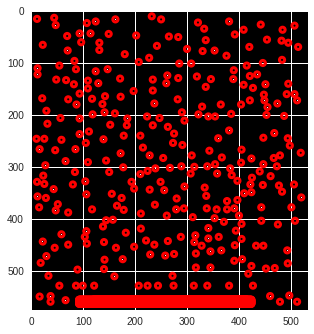

<Figure size 576x396 with 0 Axes>

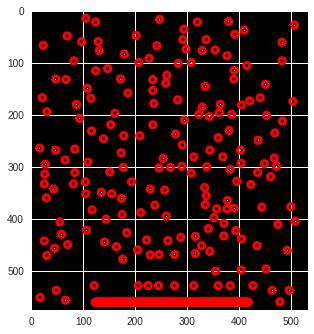

<Figure size 576x396 with 0 Axes>

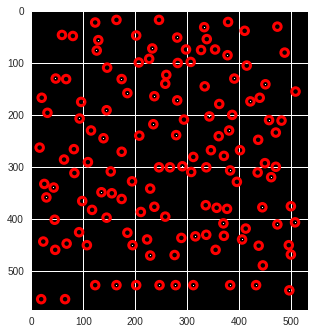

<Figure size 576x396 with 0 Axes>

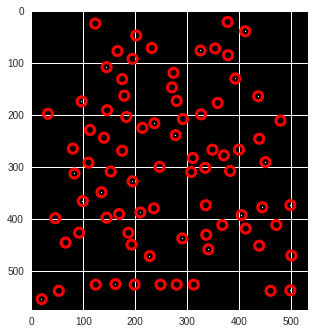

<Figure size 576x396 with 0 Axes>

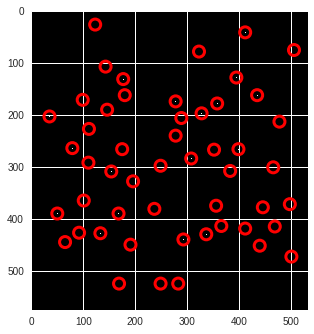

<Figure size 576x396 with 0 Axes>

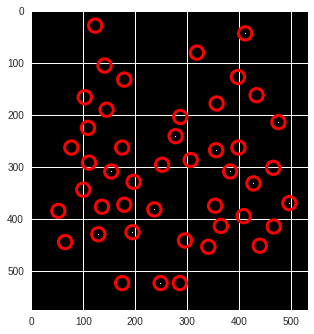

<Figure size 576x396 with 0 Axes>

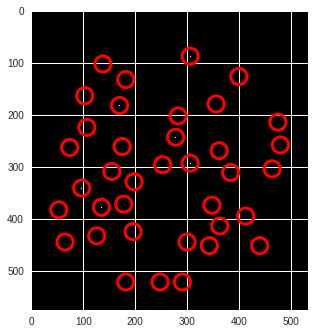

<Figure size 576x396 with 0 Axes>

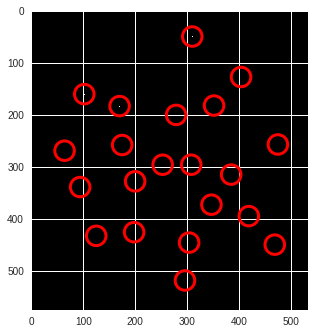

<Figure size 576x396 with 0 Axes>

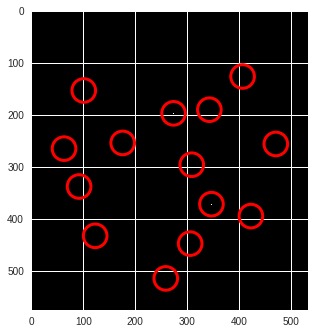

<Figure size 576x396 with 0 Axes>

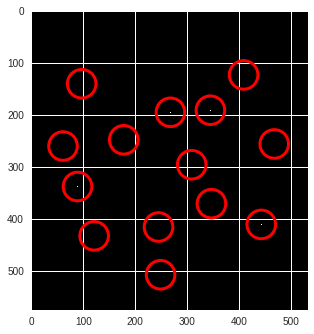

<Figure size 576x396 with 0 Axes>

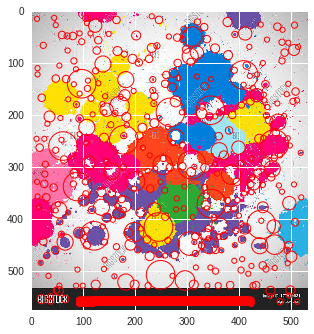

63.052472829818726


In [0]:
start = time.time()
n = 10
path = "colors.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

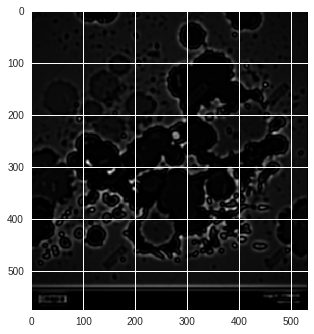

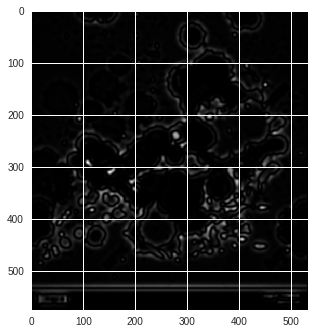

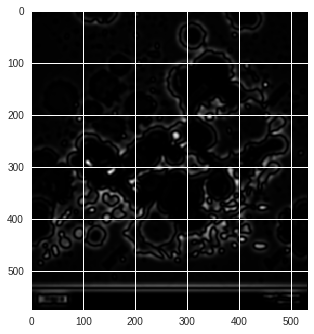

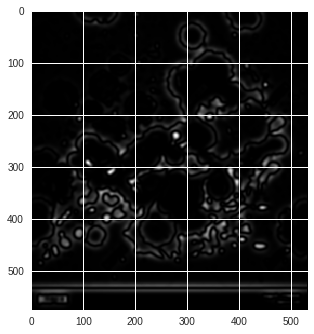

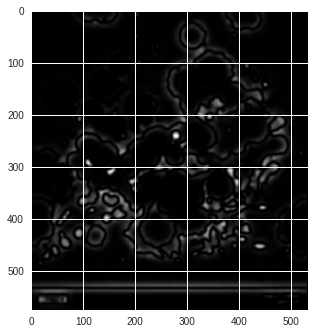

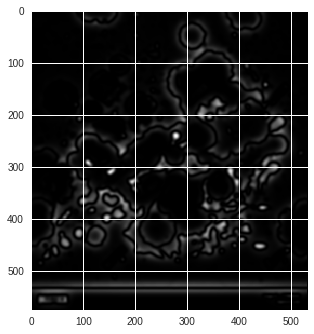

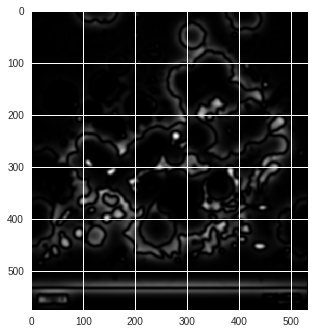

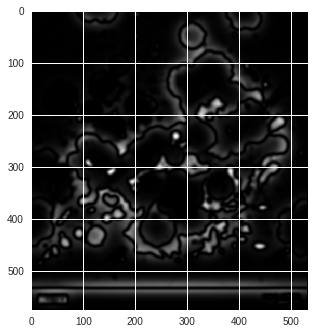

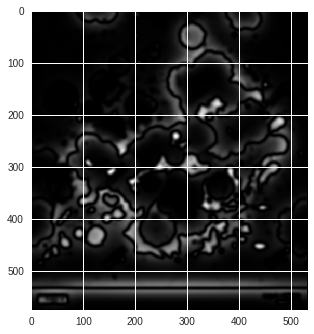

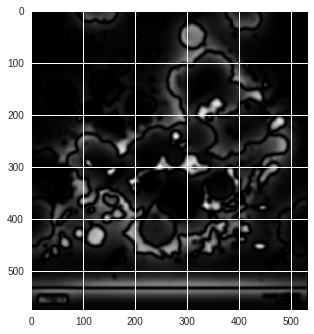

<Figure size 576x396 with 0 Axes>

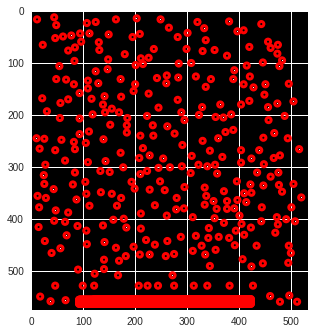

<Figure size 576x396 with 0 Axes>

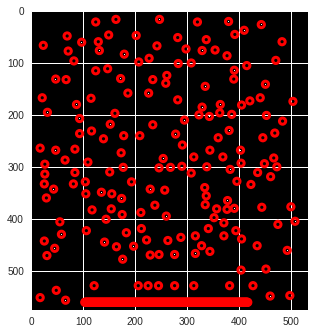

<Figure size 576x396 with 0 Axes>

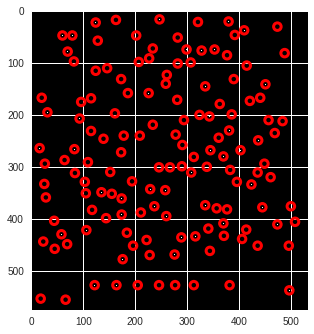

<Figure size 576x396 with 0 Axes>

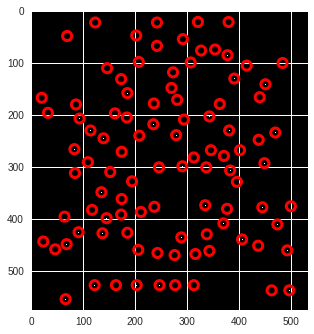

<Figure size 576x396 with 0 Axes>

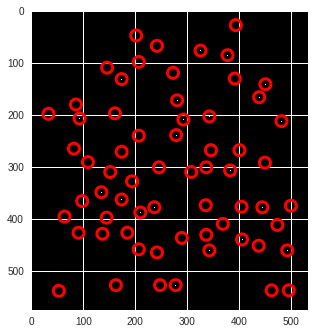

<Figure size 576x396 with 0 Axes>

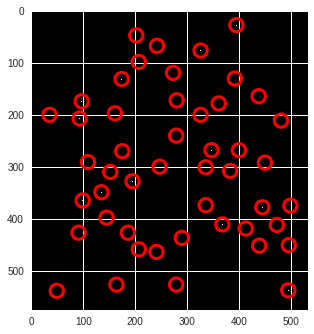

<Figure size 576x396 with 0 Axes>

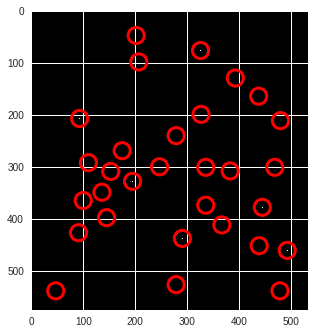

<Figure size 576x396 with 0 Axes>

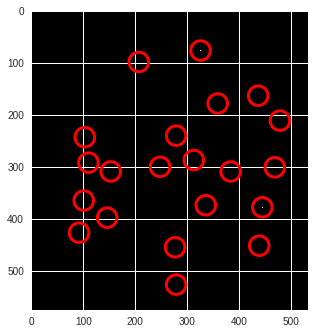

<Figure size 576x396 with 0 Axes>

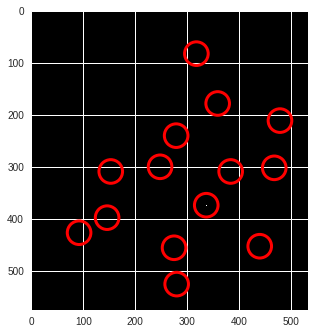

<Figure size 576x396 with 0 Axes>

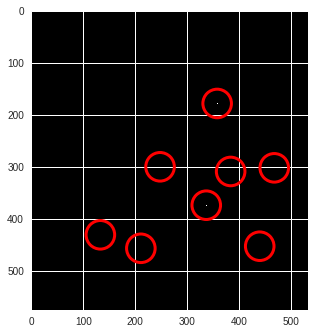

<Figure size 576x396 with 0 Axes>

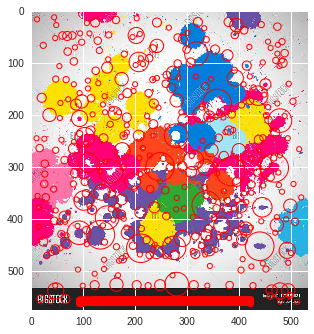

63.8885293006897


In [0]:
start = time.time()
n = 10
path = "colors.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

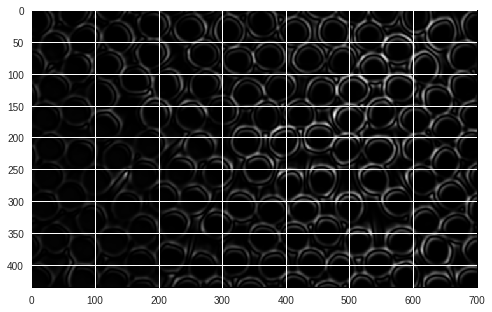

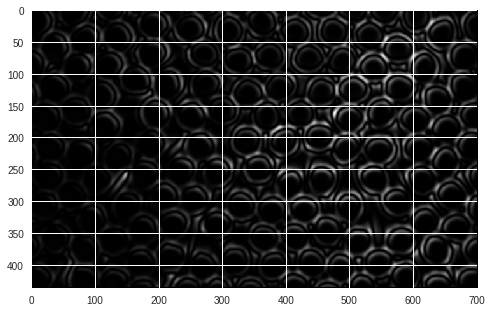

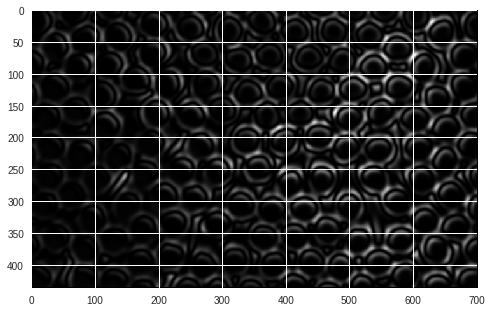

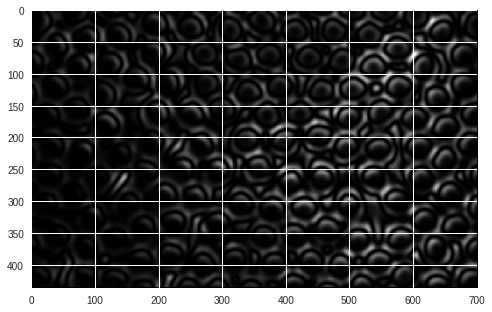

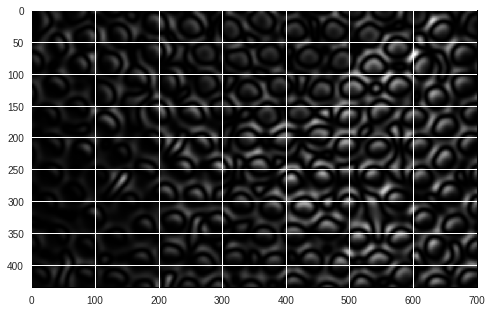

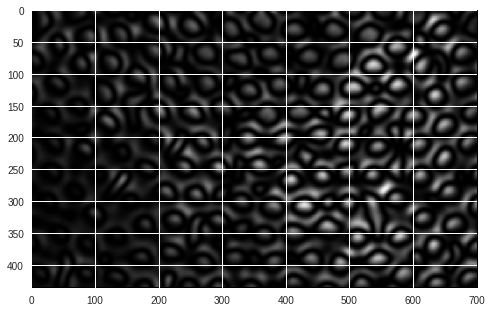

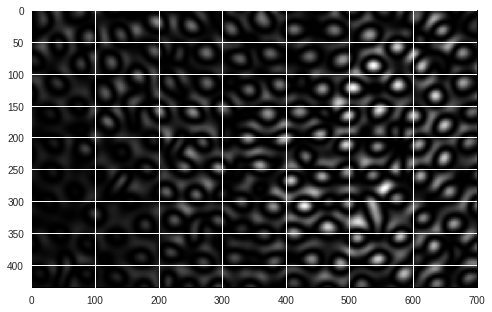

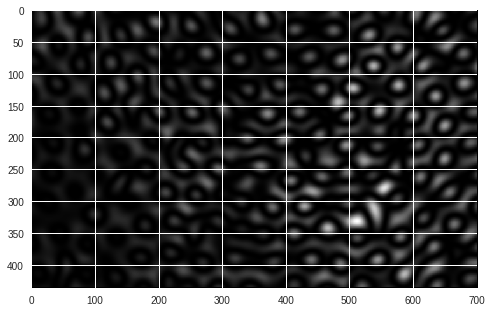

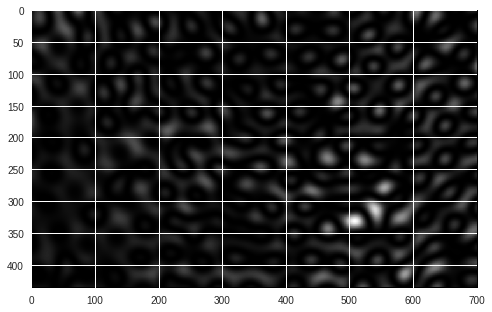

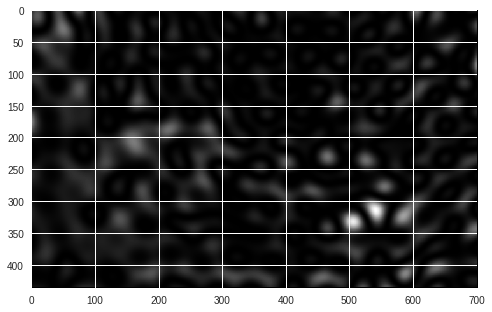

<Figure size 576x396 with 0 Axes>

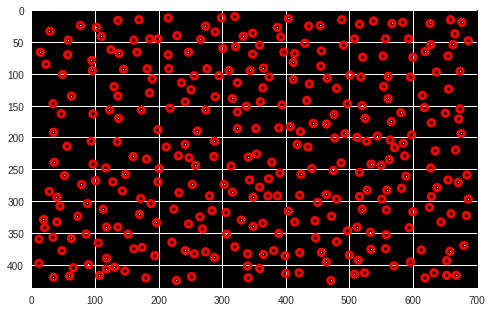

<Figure size 576x396 with 0 Axes>

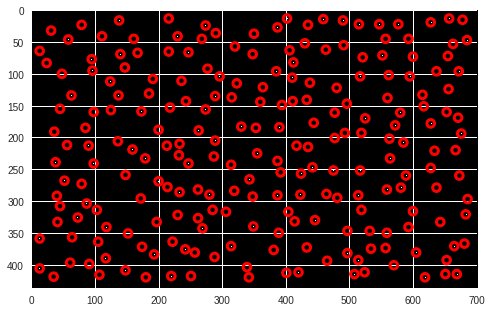

<Figure size 576x396 with 0 Axes>

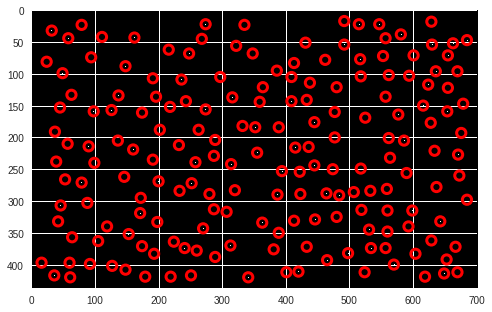

<Figure size 576x396 with 0 Axes>

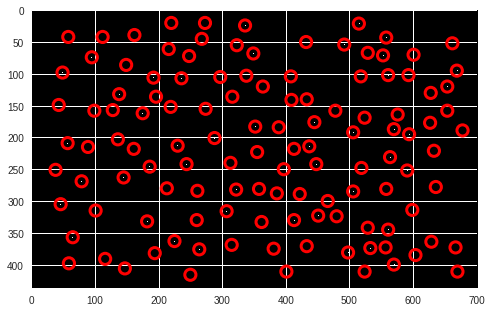

<Figure size 576x396 with 0 Axes>

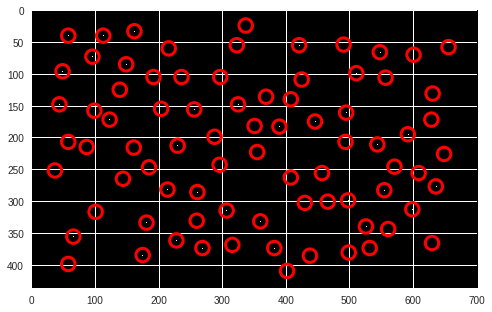

<Figure size 576x396 with 0 Axes>

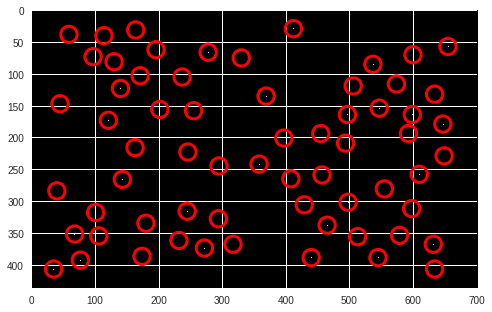

<Figure size 576x396 with 0 Axes>

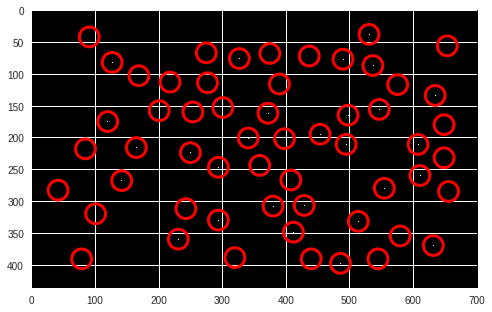

<Figure size 576x396 with 0 Axes>

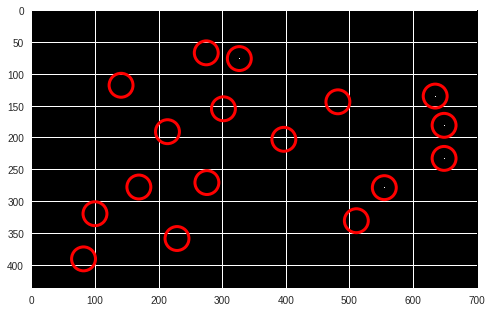

<Figure size 576x396 with 0 Axes>

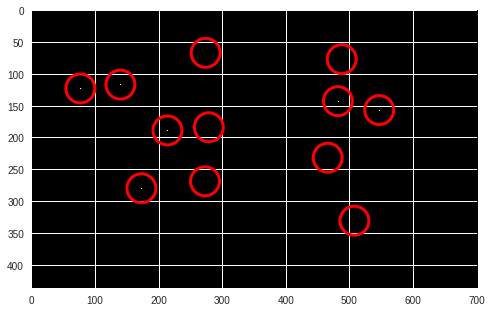

<Figure size 576x396 with 0 Axes>

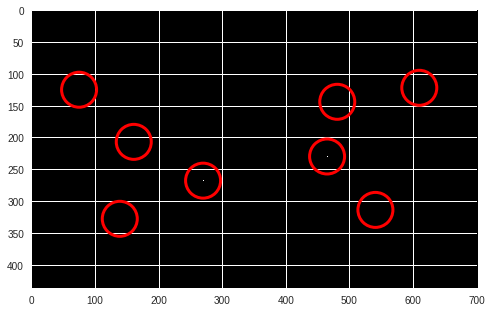

<Figure size 576x396 with 0 Axes>

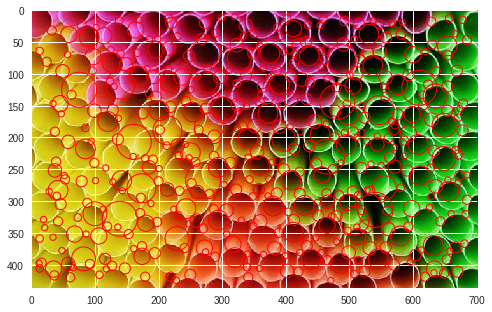

58.875545263290405


In [0]:
start = time.time()
n = 10
path = "rods.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image)
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

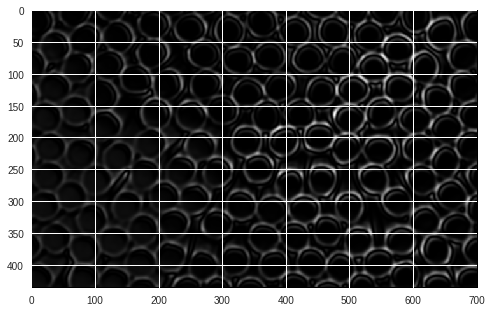

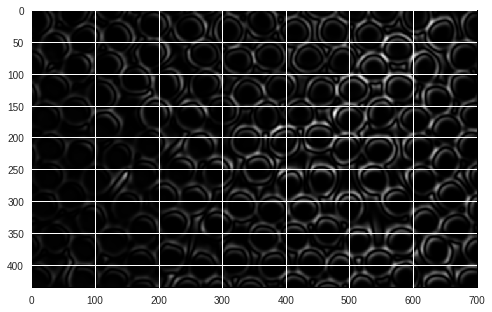

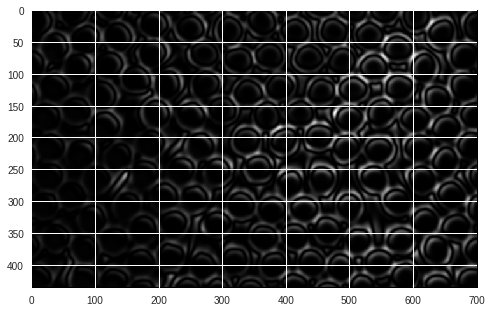

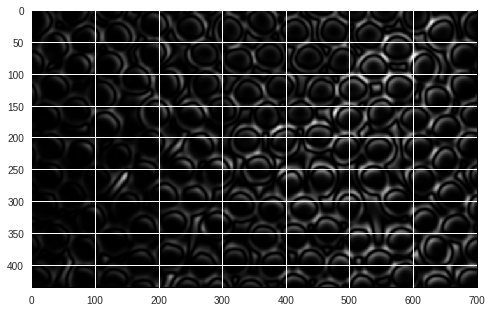

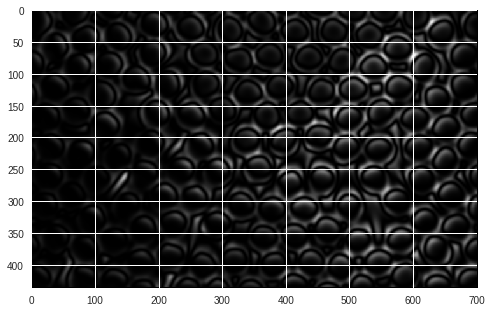

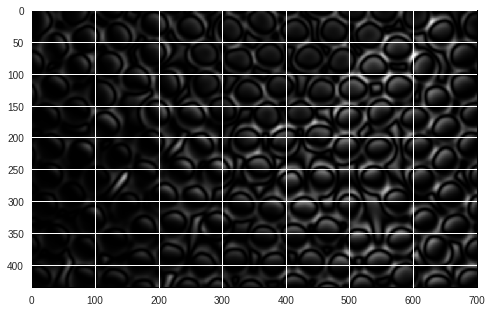

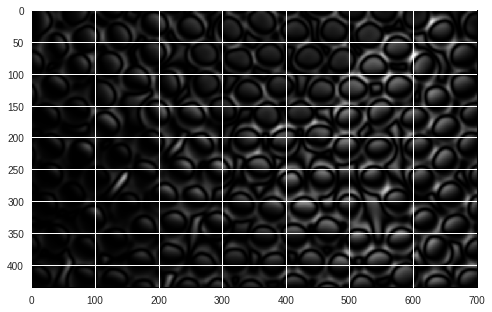

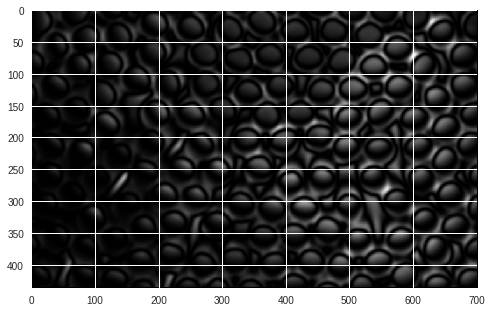

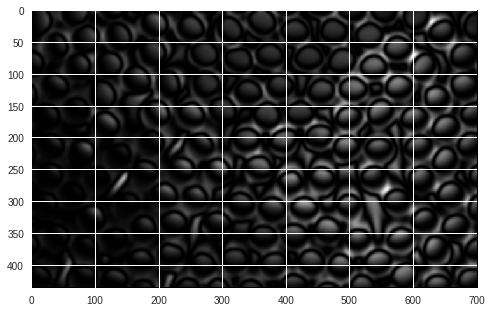

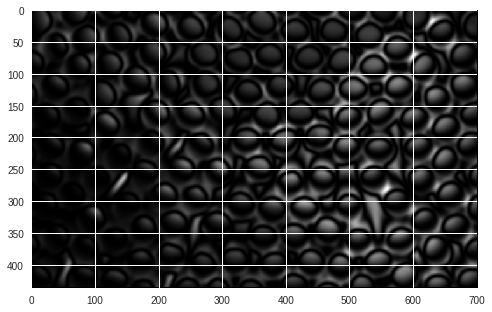

<Figure size 576x396 with 0 Axes>

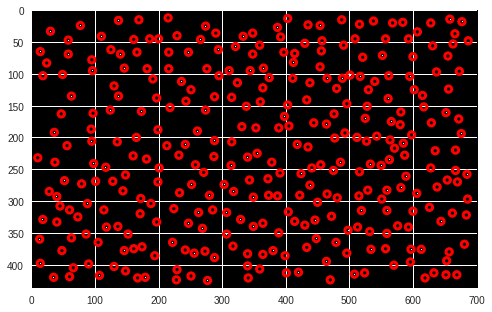

<Figure size 576x396 with 0 Axes>

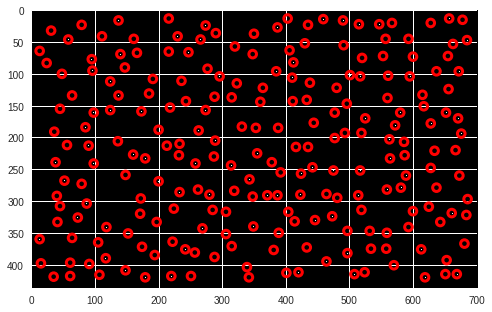

<Figure size 576x396 with 0 Axes>

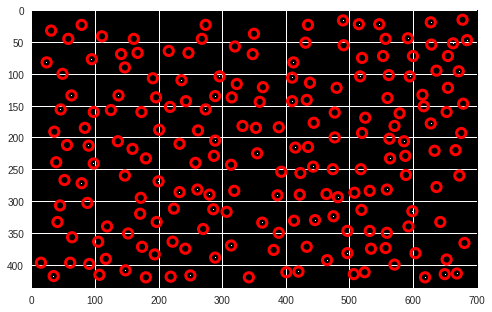

<Figure size 576x396 with 0 Axes>

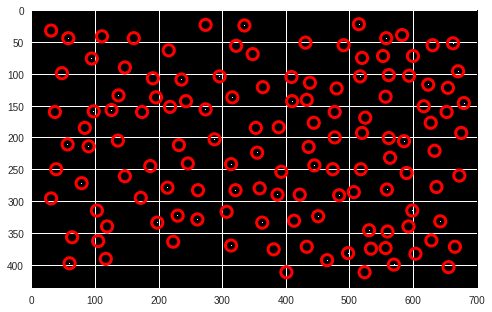

<Figure size 576x396 with 0 Axes>

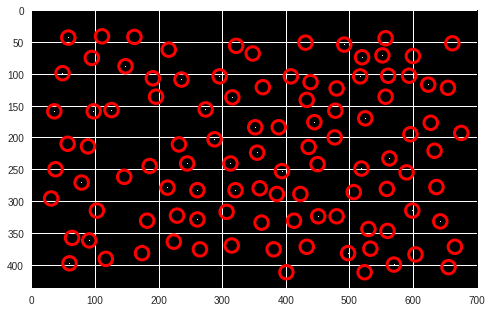

<Figure size 576x396 with 0 Axes>

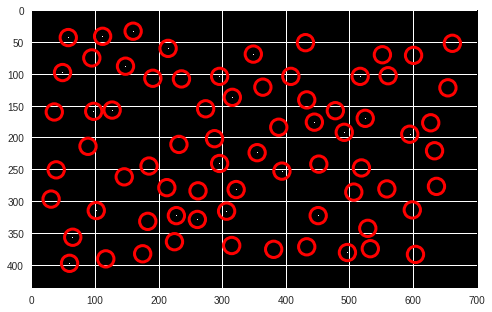

<Figure size 576x396 with 0 Axes>

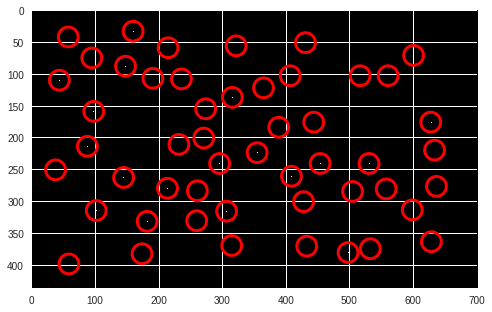

<Figure size 576x396 with 0 Axes>

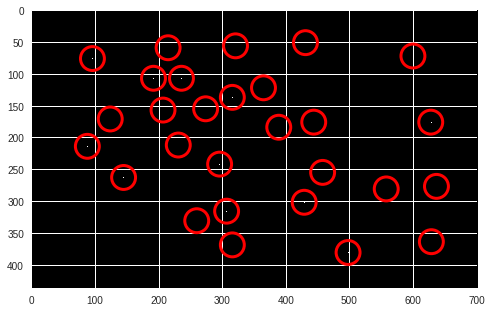

<Figure size 576x396 with 0 Axes>

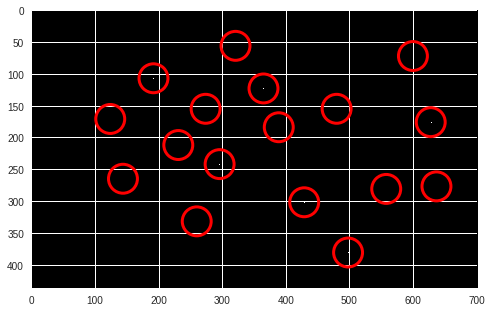

<Figure size 576x396 with 0 Axes>

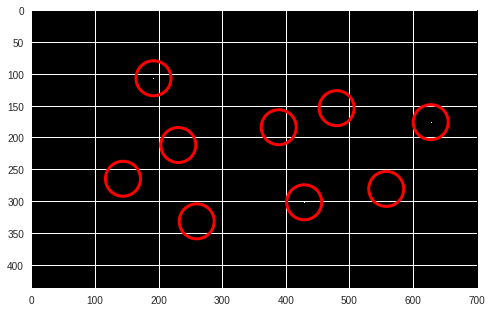

<Figure size 576x396 with 0 Axes>

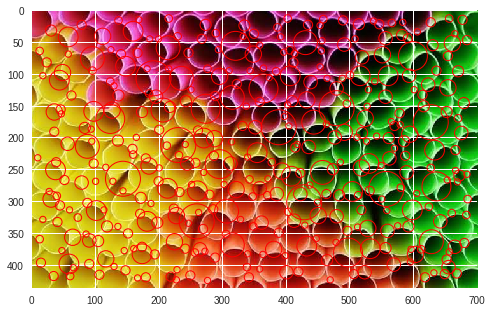

58.92578172683716


In [0]:
start = time.time()
n = 10
path = "rods.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

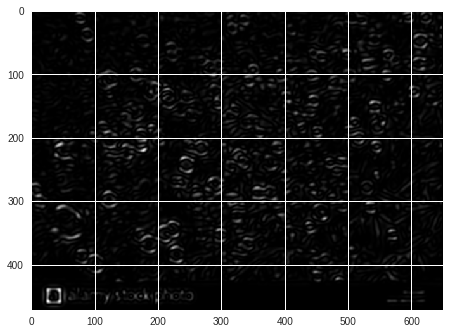

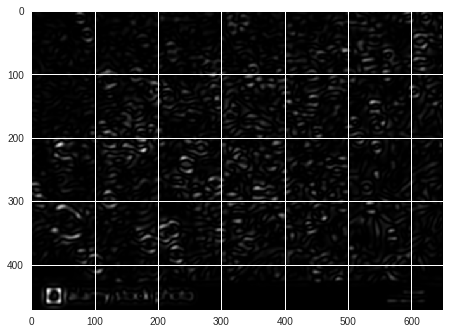

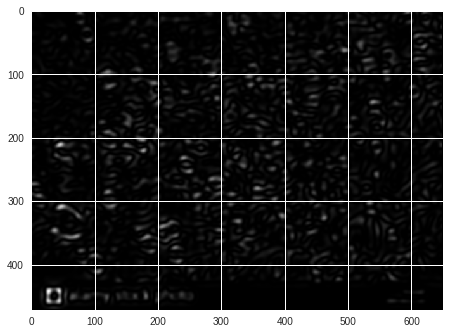

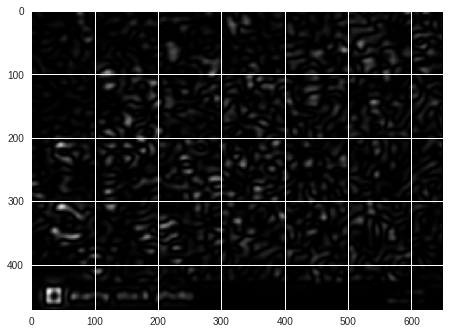

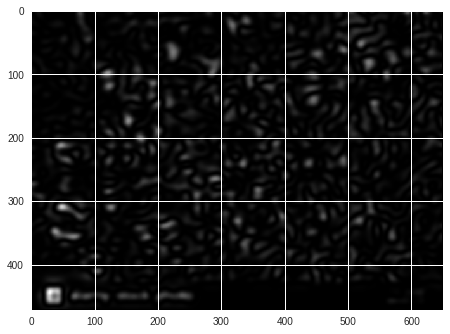

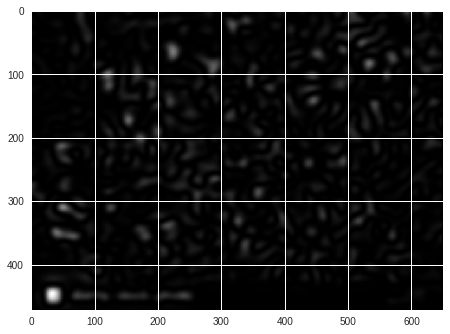

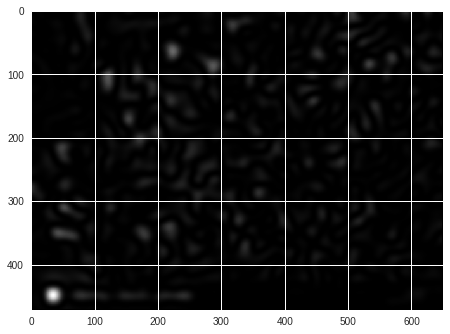

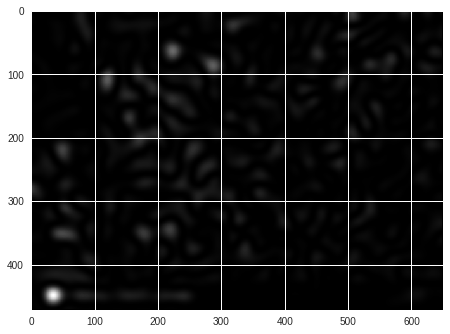

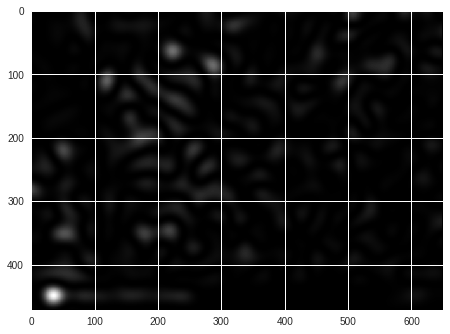

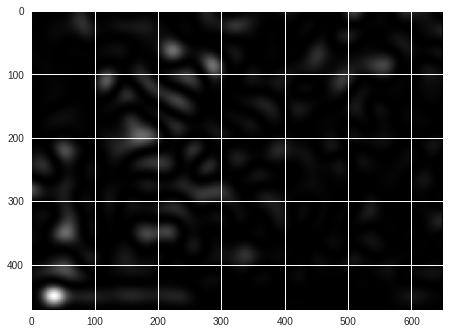

<Figure size 576x396 with 0 Axes>

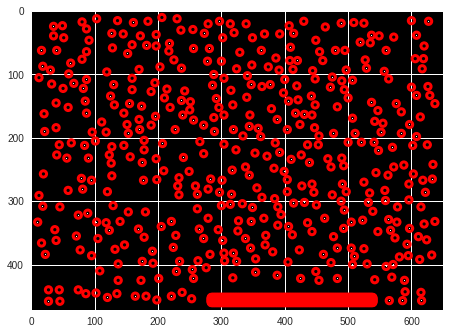

<Figure size 576x396 with 0 Axes>

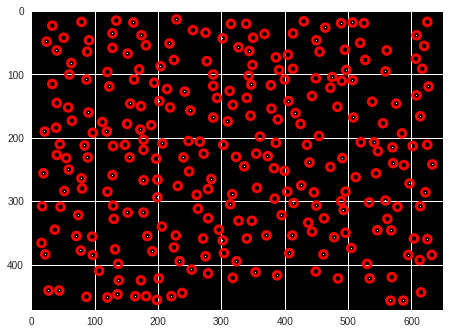

<Figure size 576x396 with 0 Axes>

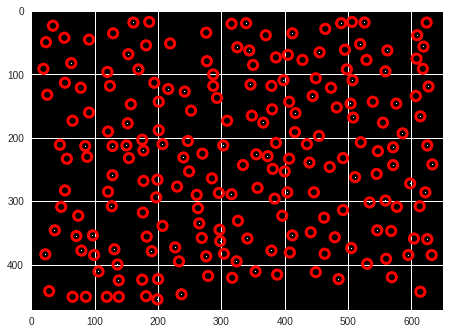

<Figure size 576x396 with 0 Axes>

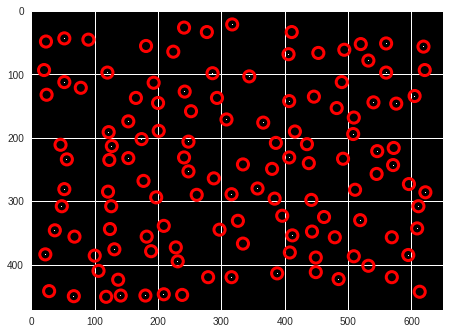

<Figure size 576x396 with 0 Axes>

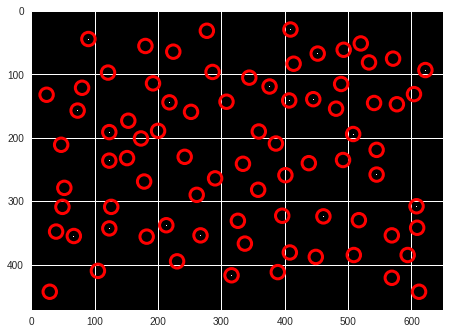

<Figure size 576x396 with 0 Axes>

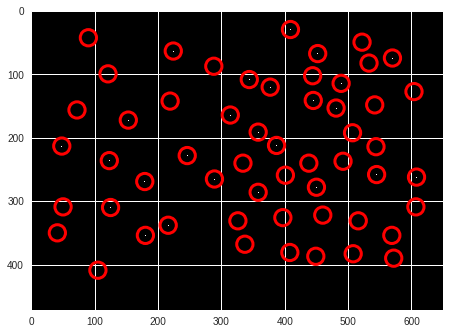

<Figure size 576x396 with 0 Axes>

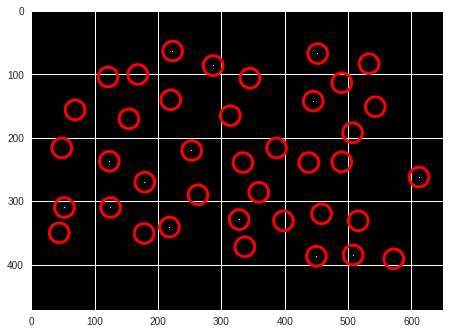

<Figure size 576x396 with 0 Axes>

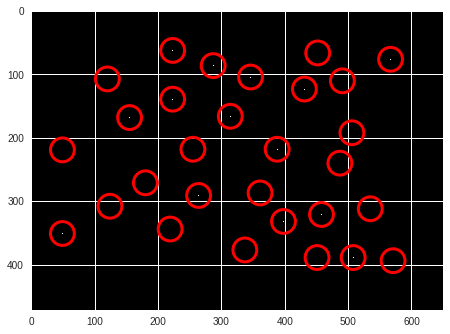

<Figure size 576x396 with 0 Axes>

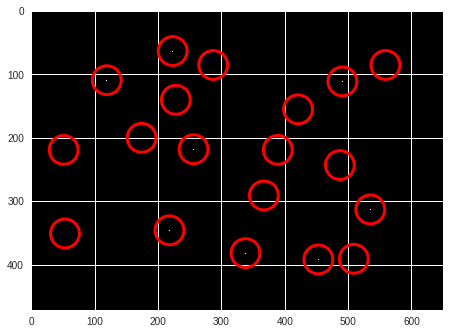

<Figure size 576x396 with 0 Axes>

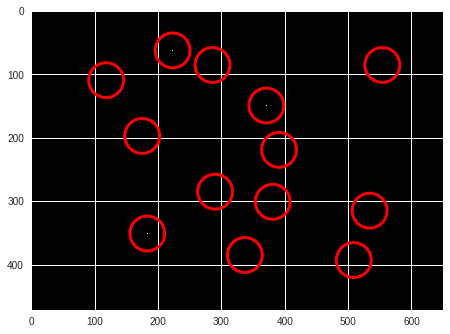

<Figure size 576x396 with 0 Axes>

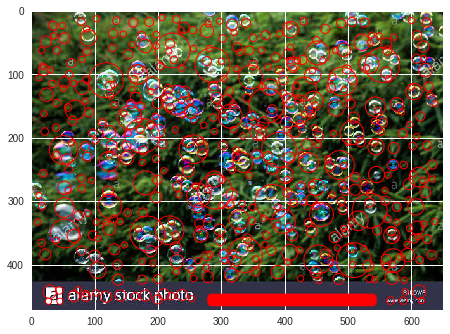

63.670729637145996


In [0]:
start = time.time()
n = 10
path = "bubbles.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 1
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image)
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)

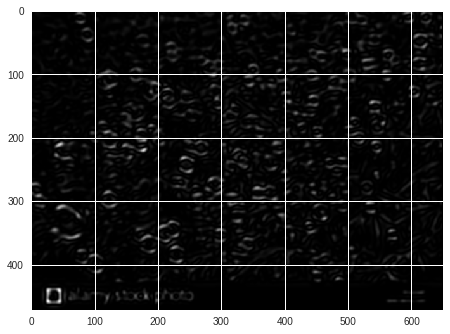

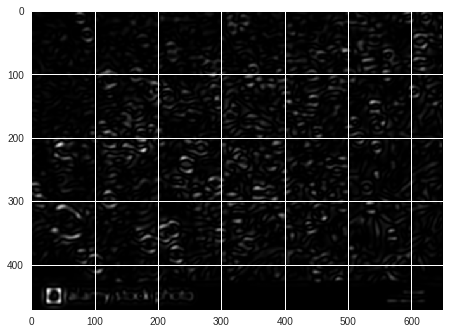

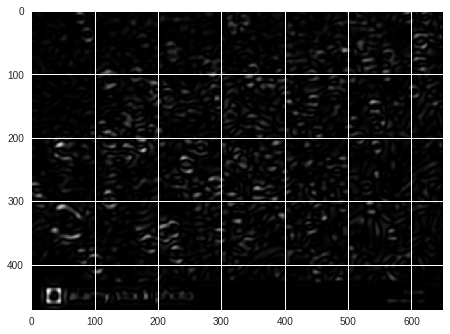

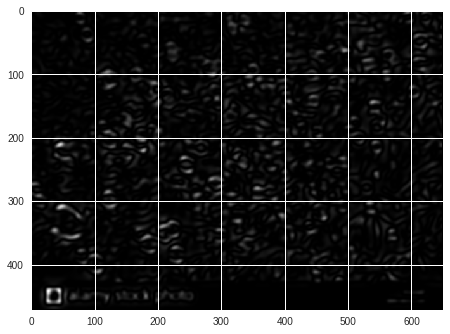

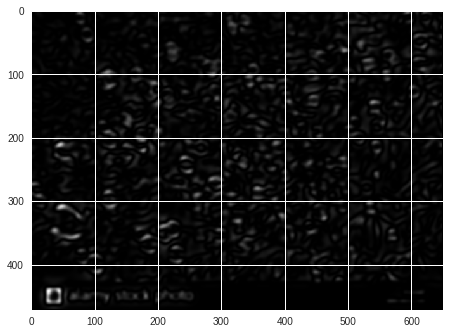

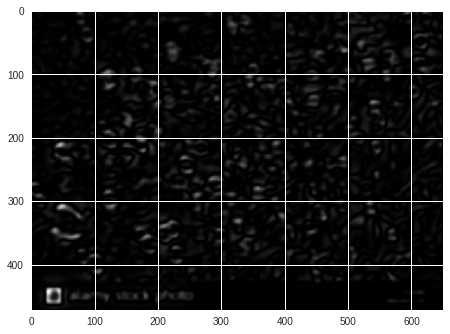

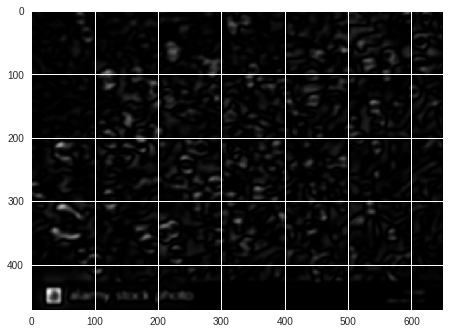

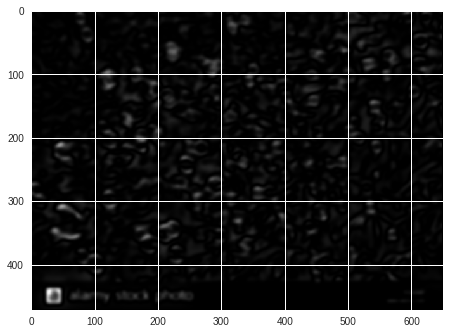

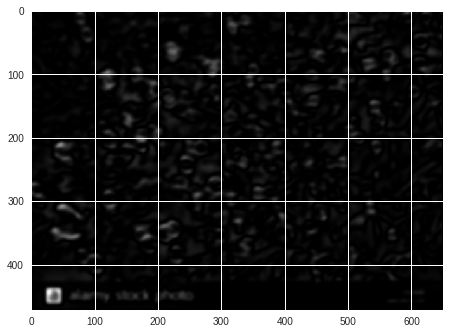

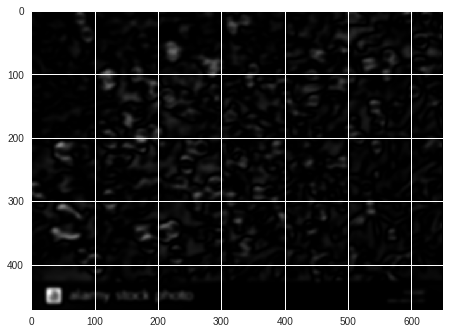

<Figure size 576x396 with 0 Axes>

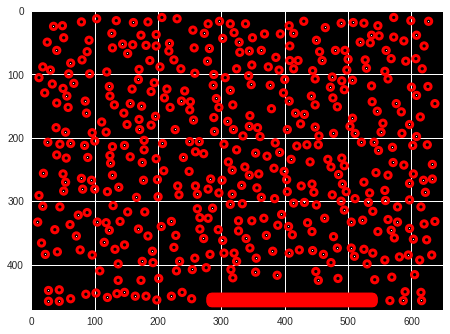

<Figure size 576x396 with 0 Axes>

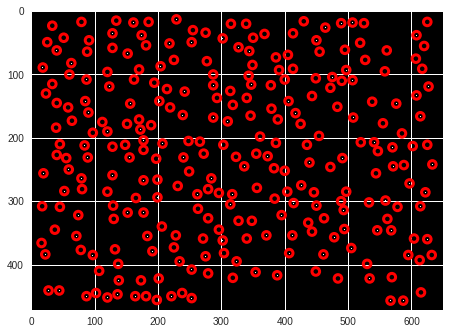

<Figure size 576x396 with 0 Axes>

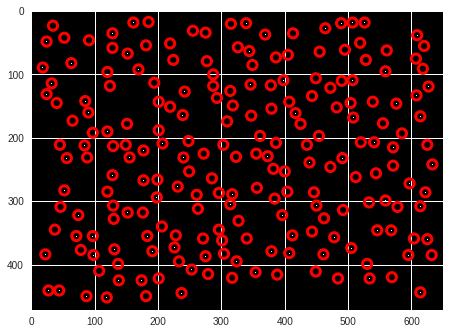

<Figure size 576x396 with 0 Axes>

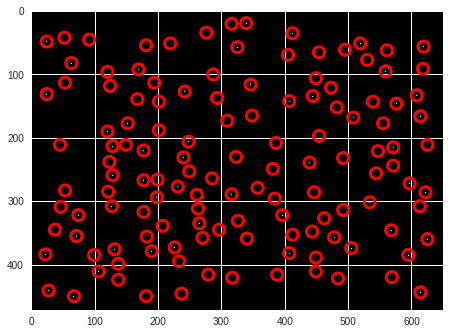

<Figure size 576x396 with 0 Axes>

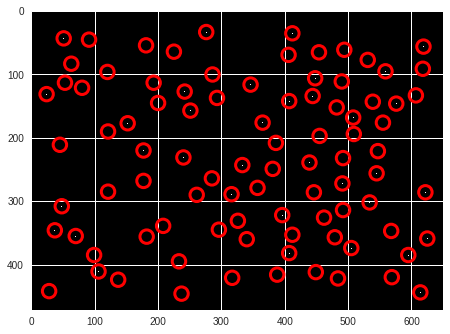

<Figure size 576x396 with 0 Axes>

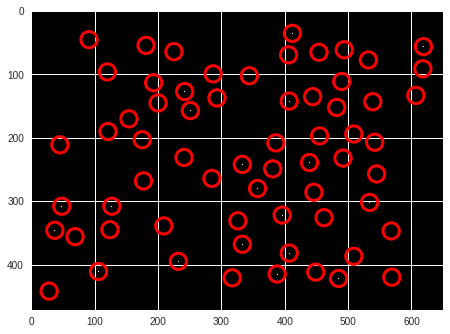

<Figure size 576x396 with 0 Axes>

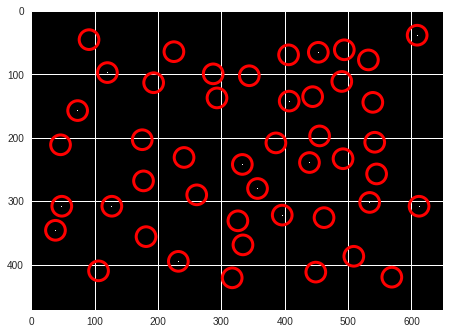

<Figure size 576x396 with 0 Axes>

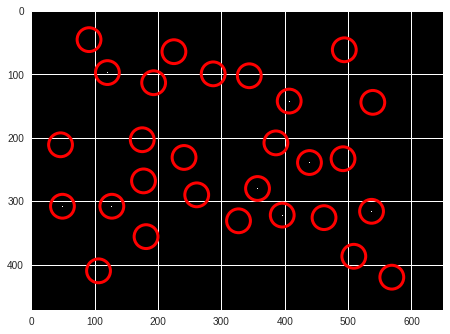

<Figure size 576x396 with 0 Axes>

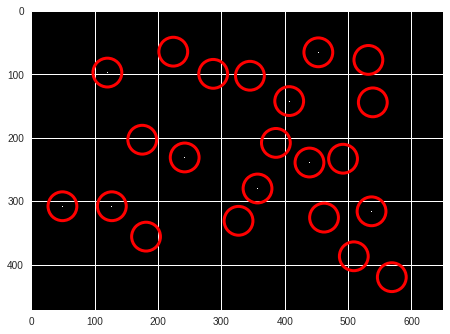

<Figure size 576x396 with 0 Axes>

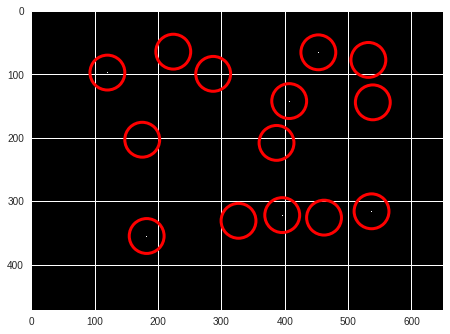

<Figure size 576x396 with 0 Axes>

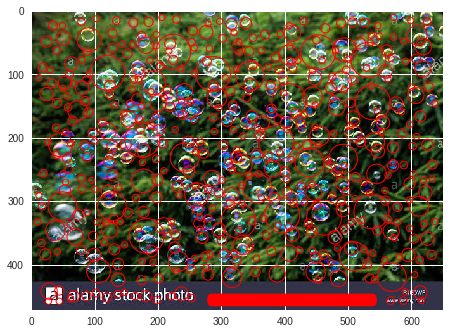

64.42570161819458


In [0]:
start = time.time()
n = 10
path = "bubbles.jpeg"
org_sigma=3.5
factor = 1.21
filter_type = 2
org_image = mpimg.imread(path)
if(len(org_image.shape) == 3):
    image = np.dot(org_image[...,:3], [0.299, 0.587, 0.114])
else:
    image = org_image
layers = np.zeros((n, image.shape[0], image.shape[1]))
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    if(filter_type == 1):
      LoG = Laplacian_of_Gaussian(window_size, sigma)
    else:
      LoG=dog(np.power(factor, i+1),window_size,org_sigma)
    plt.figure()
    layers[i] = apply_filter(padding(image, window_size), LoG)[window_size//2:-window_size//2+1, window_size//2:-window_size//2+1]
    plt.imshow(layers[i], cmap = "gray")
centres = np.zeros(layers.shape)
for i in range(n):
    sigma = org_sigma*np.power(factor, i)
    window_size = int(np.ceil(6*sigma))
    if(window_size%2 == 0):
        window_size += 1
    centres[i] = max_filter(layers[i], window_size, sigma)
plt.figure()
fig, ax = plt.subplots()
for i in range(centres.shape[0]):
    sigma = org_sigma*np.power(factor, i)
    for j in range(centres.shape[1]):
        for k in range(centres.shape[2]):
            if(centres[i][j][k]!=0 and centres[i, j, k] == np.max(centres[:, int(j-np.sqrt(2)*sigma):int(j+np.sqrt(2)*sigma), k-int(np.sqrt(2)*sigma):k+int(np.sqrt(2)*sigma)])):
                ax.add_artist(plt.Circle((k, j), np.sqrt(2)*sigma, color='r', fill = False, linewidth=1))
plt.imshow(org_image, cmap="gray")
plt.show()
end = time.time()
elapsed = end - start
print(elapsed)